<h1>ZMGSN Lista 2. - Variational Autoencoder (VAE)</h1>

<h2>Opis zadania</h2>

W ramach zadania należy:
<ol>
<li>Zapoznać się z poniższym eksperymentem z wykorzystaniem modelu VAE</li>
<li>Dokonać analizy wpływu hiperparametrów eksperymentu, np. kroku uczenia, rozmiaru pakietu (ang. <i>batch size</i>), liczby epok na wyniki modelu VAE</li>
<li>Zaimplementować koder (ang. encoder) kompatybilny z dekoderem wykorzystanym w poniższym eksperymencie</li>
<li>Połączyć zaimplementowany koder z dostępnym dekoderem w celu opracowania autokodera (ang. autoencoder - AE)</li>
<li>Opracować pętlę uczącą dopasowaną do sieci typu Autoencoder</li>
<li>Dokonać ewaluacji opracowanej sieci typu Autoencoder</li>
<li>Porównać wyniki działania modelu AE z modelem VAE</li>
<li>Dokonać ewaluacji innych wariantów sieci VAE, np. Concrete VAE, BVAE, NVAE itp.</li>
<li>Opracować procedurę ewaluacji jakości działania modeli AE, VAE i innych rozważanych wariantów, uwzględniającą różne metody wizualizacji (np. wykresy, miary, klasy), klasteryzacji, redukcji wymiarów (np. t-SNE)</li>
</ol>

Ocenie podlegać będzie jakość wykonania zadania, w tym:
<ol>
<li>Właściwe wykonanie zadań</li>
<li>Rzetelne opracowanie wyników, uwzględniające analizę jakościową i ilościową</li>
<li>Opracowanie wniosków mających na celu wyjaśnienie badanych zjawisk i uzyskanych wyników</li>
<li>Opracowanie i wyjaśnienie kodu źródłowego</li>
</ol>


<h2>Import używanych bibliotek</h2>

In [1]:
import matplotlib.pyplot as plt
import numpy as np
import torch
import torch.nn as nn
import torch.nn.functional as F
import torch.utils
import torch.distributions
import torchvision
import pickle
import torch.optim as optim
from torchvision import datasets, transforms
import torch.distributions as td

<h2>Inicjalizacja ziarna generatora liczb pseudolosowych</h2>

In [2]:
torch.manual_seed(0)

<h2>Konfiguracja stylu prezentacji wykresów generowanych za pomocą biblioteki Matplotlib</h2>

In [3]:
plt.rcParams['figure.dpi'] = 200

<h2>Określenie domyślnego urządzenia na podstawie sprawdzenia dostępności karty graficznej</h2>

In [4]:
device = torch.device('cuda') if torch.cuda.is_available() else torch.device('cpu')
print(device)

cuda


<h2>Określenie wymiarowości ukrytej przestrzeni wektorowej, w której będą przechowywane ukryte reprezentacje danych wejściowych</h2>

In [5]:
latent_dims = 2

<h2>Pobranie i rozpakowanie zbioru danych</h2>

In [6]:
data = torch.utils.data.DataLoader(
        torchvision.datasets.MNIST('./data',
               transform=torchvision.transforms.ToTensor(),
               download=True),
        batch_size=128,
        shuffle=True)

<h2>Deklaracja podstawowej klasy kodera wariacyjnego (ang. variational encoder)<h2>

In [12]:
class VariationalEncoder(nn.Module):
    def __init__(self, latent_dims):
        super(VariationalEncoder, self).__init__()
        self.linear1 = nn.Linear(784, 512)
        self.linear2 = nn.Linear(512, latent_dims)
        self.linear3 = nn.Linear(512, latent_dims)

        self.N = torch.distributions.Normal(0, 1)
        # umożliwienie próbkowania wielowymiarowego rozkładu na karcie graficznej
        self.N.loc = self.N.loc.cuda() if torch.cuda.is_available() else self.N.loc
        self.N.scale = self.N.scale.cuda() if torch.cuda.is_available() else self.N.scale
        self.kl = 0

    def forward(self, x):
        x = torch.flatten(x, start_dim=1)
        x = F.relu(self.linear1(x))
        mu =  self.linear2(x)
        sigma = torch.exp(self.linear3(x))
        z = mu + sigma*self.N.sample(mu.shape)
        self.kl = (((sigma**2 + mu**2) / 2) - torch.log(sigma) - 1/2).sum()
        return z

<h2>Deklaracja podstawowej klasy dekodera</h2>

In [7]:
class Decoder(nn.Module):
    def __init__(self, latent_dims):
        super(Decoder, self).__init__()
        self.linear1 = nn.Linear(latent_dims, 512)
        self.linear2 = nn.Linear(512, 784)

    def forward(self, z):
        z = F.relu(self.linear1(z))
        z = torch.sigmoid(self.linear2(z))
        return z.reshape((-1, 1, 28, 28))

<h2>Deklaracja podstawowej klasy wariacyjnego autokodera (ang. variational autoencoder - VAE)</h2>

In [9]:
class VariationalAutoencoder(nn.Module):
    def __init__(self, latent_dims):
        super(VariationalAutoencoder, self).__init__()
        self.encoder = VariationalEncoder(latent_dims)
        self.decoder = Decoder(latent_dims)

    def forward(self, x):
        z = self.encoder(x)
        return self.decoder(z)

<h2>Przykładowa pętla ucząca</h2>

In [10]:
def train(autoencoder, data, epochs=25, learning_rate=0.001):
    opt = torch.optim.Adam(autoencoder.parameters(), lr=learning_rate)
    avg_losses = []
    for epoch in range(epochs):
        loss_list = []
        for x, _ in data:
            x = x.to(device)
            opt.zero_grad()
            x_hat = autoencoder(x)
            loss = ((x - x_hat)**2).sum() + autoencoder.encoder.kl
            loss.backward()
            opt.step()
            loss_list.append(loss.item())
        avg_loss = np.mean(loss_list)
        avg_losses.append(avg_loss)
        print(f"Epoch [{epoch+1}/{epochs}], avg_loss: {avg_loss:.4f}")
    filename = 'vae.sav'
    pickle.dump(autoencoder, open(filename, 'wb'))
    return autoencoder, avg_losses


<h2>Inicjalizacja sieci VAE i uruchomienie procesu uczenia</h2>

In [13]:
vae = VariationalAutoencoder(latent_dims).to(device)
vae, avg_losses = train(vae, data)

Epoch [1/25], avg_loss: 6134.2580
Epoch [2/25], avg_loss: 5299.0827
Epoch [3/25], avg_loss: 5168.8545
Epoch [4/25], avg_loss: 5091.8573
Epoch [5/25], avg_loss: 5039.0051
Epoch [6/25], avg_loss: 4993.6042
Epoch [7/25], avg_loss: 4958.8016
Epoch [8/25], avg_loss: 4929.8583
Epoch [9/25], avg_loss: 4899.4826
Epoch [10/25], avg_loss: 4875.5289
Epoch [11/25], avg_loss: 4854.0743
Epoch [12/25], avg_loss: 4833.9103
Epoch [13/25], avg_loss: 4815.4124
Epoch [14/25], avg_loss: 4802.3976
Epoch [15/25], avg_loss: 4784.8509
Epoch [16/25], avg_loss: 4772.7675
Epoch [17/25], avg_loss: 4761.1088
Epoch [18/25], avg_loss: 4748.7566
Epoch [19/25], avg_loss: 4739.5410
Epoch [20/25], avg_loss: 4727.4574
Epoch [21/25], avg_loss: 4717.9138
Epoch [22/25], avg_loss: 4708.5402
Epoch [23/25], avg_loss: 4703.2412
Epoch [24/25], avg_loss: 4694.1269
Epoch [25/25], avg_loss: 4687.8036


<h2>Funkcja pomocniczna służąca do wizualizacji ukrytej wektorowej reprezentacji (ang. latent vector) danych wejściowych</h2>

In [8]:
def plot_latent(autoencoder, data, num_batches=100):
    for i, (x, y) in enumerate(data):
        z = autoencoder.encoder(x.to(device))
        z = z.to('cpu').detach().numpy()
        plt.scatter(z[:, 0], z[:, 1], c=y, cmap='tab10')
        if i > num_batches:
            plt.colorbar()
            break

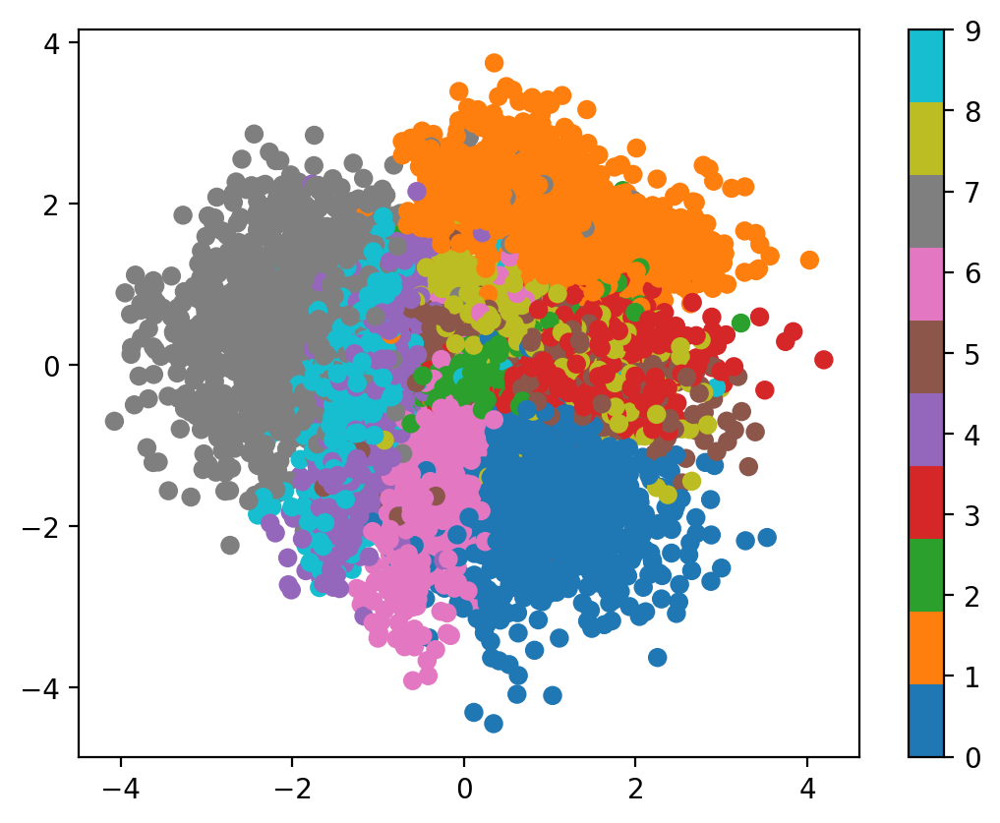

In [15]:
plot_latent(vae, data)

<h2>Funkcja pomocniczna służąca do jednostajnego próbkowania wyuczonej przestrzeni wektorowej (ang. latent vector space), z której sieć VAE czerpie ukryte reprezentacje wektorowe danych wejściowych</h2>

In [9]:
def plot_reconstructed(autoencoder, r0=(-5, 10), r1=(-10, 5), n=12):
    w = 28
    img = np.zeros((n*w, n*w))
    for i, y in enumerate(np.linspace(*r1, n)):
        for j, x in enumerate(np.linspace(*r0, n)):
            z = torch.Tensor([[x, y]]).to(device)
            x_hat = autoencoder.decoder(z)
            x_hat = x_hat.reshape(28, 28).to('cpu').detach().numpy()
            img[(n-1-i)*w:(n-1-i+1)*w, j*w:(j+1)*w] = x_hat
    plt.imshow(img, extent=[*r0, *r1])

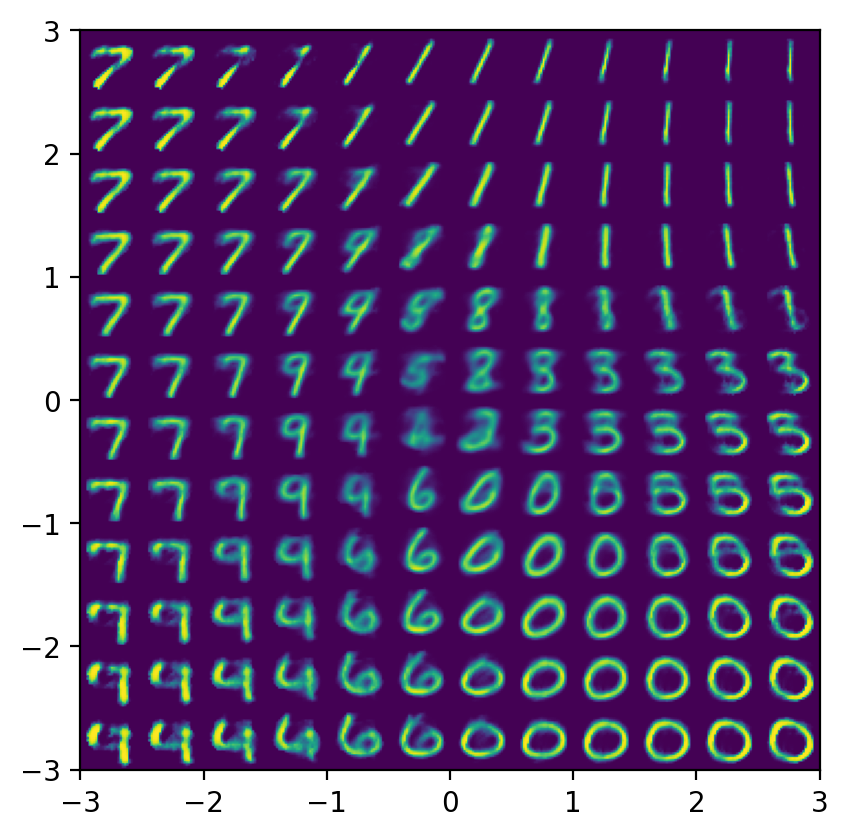

In [17]:
plot_reconstructed(vae, r0=(-3, 3), r1=(-3, 3))

<h2>Funkcja pomocnicza pozwalająca na interpolację</h2>

In [10]:
def interpolate(autoencoder, x_1, x_2, n=12):
    z_1 = autoencoder.encoder(x_1)
    z_2 = autoencoder.encoder(x_2)
    z = torch.stack([z_1 + (z_2 - z_1)*t for t in np.linspace(0, 1, n)])
    interpolate_list = autoencoder.decoder(z)
    interpolate_list = interpolate_list.to('cpu').detach().numpy()

    w = 28
    img = np.zeros((w, n*w))
    for i, x_hat in enumerate(interpolate_list):
        img[:, i*w:(i+1)*w] = x_hat.reshape(28, 28)
    plt.imshow(img)
    plt.xticks([])
    plt.yticks([])

In [11]:
# Uzyskanie pakietu próbek (ang. batch) ze zbioru uczącego
# x, y = data.__iter__().next()
x, y = next(iter(data))

# Uzyskanie próbki należącej do klasy "1"
x_1 = x[y == 1][1].to(device)

# Uzyskanie próbki należącej do klasy "0"
x_2 = x[y == 0][1].to(device)

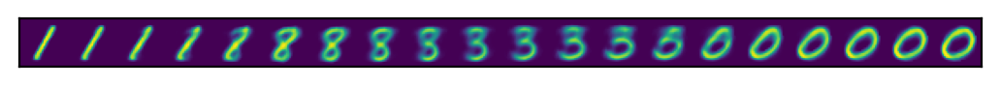

In [24]:
interpolate(vae, x_1, x_2, n=20)

Zadanie 2

In [15]:
def plot_reconstructed(autoencoder, r0=(-5, 10), r1=(-10, 5), n=12, latent_dims=2):
    w = 28
    img = np.zeros((n*w, n*w))
    for i, y in enumerate(np.linspace(*r1, n)):
        for j, x in enumerate(np.linspace(*r0, n)):
            z_sample = [x, y] + [0.5]*(latent_dims-2)
            z = torch.Tensor([z_sample]).to(device)
            x_hat = autoencoder.decoder(z)
            x_hat = x_hat.reshape(28, 28).to('cpu').detach().numpy()
            img[(n-1-i)*w:(n-1-i+1)*w, j*w:(j+1)*w] = x_hat
    plt.imshow(img, extent=[*r0, *r1])


Epoch [1/25], avg_loss: 6193.6788
Epoch [2/25], avg_loss: 5421.0322
Epoch [3/25], avg_loss: 5294.0419
Epoch [4/25], avg_loss: 5211.1427
Epoch [5/25], avg_loss: 5147.0956
Epoch [6/25], avg_loss: 5094.4162
Epoch [7/25], avg_loss: 5051.1017
Epoch [8/25], avg_loss: 5018.2462
Epoch [9/25], avg_loss: 4989.0954
Epoch [10/25], avg_loss: 4963.2307
Epoch [11/25], avg_loss: 4940.0232
Epoch [12/25], avg_loss: 4922.7415
Epoch [13/25], avg_loss: 4906.3754
Epoch [14/25], avg_loss: 4888.3973
Epoch [15/25], avg_loss: 4872.6098
Epoch [16/25], avg_loss: 4860.3036
Epoch [17/25], avg_loss: 4846.1999
Epoch [18/25], avg_loss: 4838.6979
Epoch [19/25], avg_loss: 4822.3108
Epoch [20/25], avg_loss: 4812.2828
Epoch [21/25], avg_loss: 4802.9399
Epoch [22/25], avg_loss: 4797.9508
Epoch [23/25], avg_loss: 4786.4876
Epoch [24/25], avg_loss: 4781.4662
Epoch [25/25], avg_loss: 4773.9117


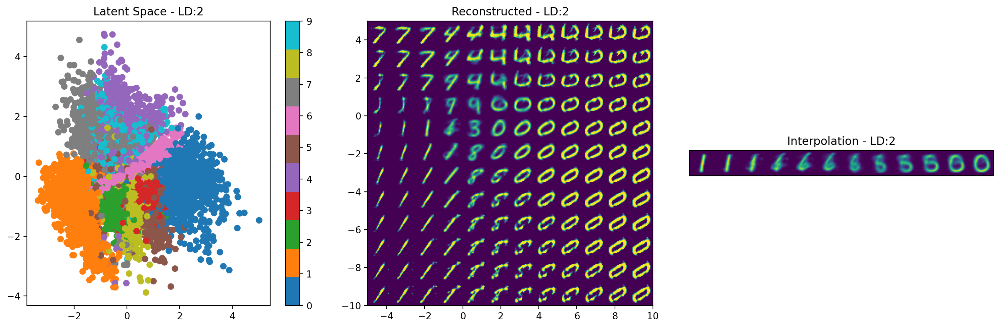

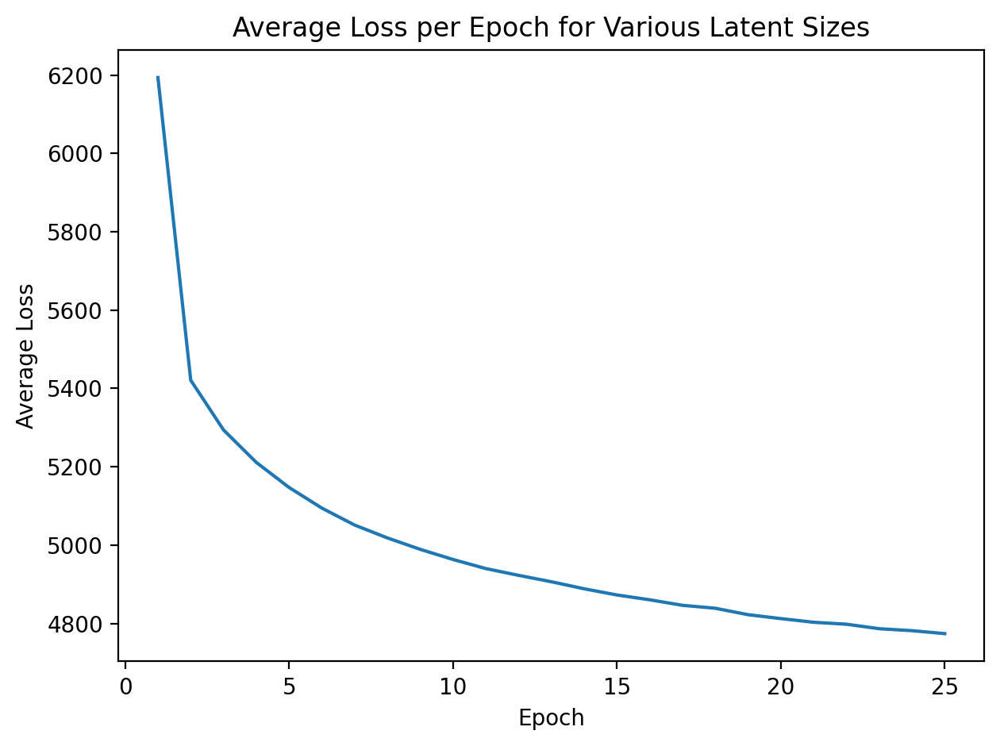

Epoch [1/25], avg_loss: 5697.4329
Epoch [2/25], avg_loss: 4687.2674
Epoch [3/25], avg_loss: 4546.9299
Epoch [4/25], avg_loss: 4464.7769
Epoch [5/25], avg_loss: 4405.9116
Epoch [6/25], avg_loss: 4363.4207
Epoch [7/25], avg_loss: 4326.8749
Epoch [8/25], avg_loss: 4299.1499
Epoch [9/25], avg_loss: 4271.2141
Epoch [10/25], avg_loss: 4251.9445
Epoch [11/25], avg_loss: 4233.7133
Epoch [12/25], avg_loss: 4216.3408
Epoch [13/25], avg_loss: 4200.0526
Epoch [14/25], avg_loss: 4188.4711
Epoch [15/25], avg_loss: 4172.9033
Epoch [16/25], avg_loss: 4165.3131
Epoch [17/25], avg_loss: 4152.4441
Epoch [18/25], avg_loss: 4145.2416
Epoch [19/25], avg_loss: 4135.1616
Epoch [20/25], avg_loss: 4125.2127
Epoch [21/25], avg_loss: 4119.3541
Epoch [22/25], avg_loss: 4112.6470
Epoch [23/25], avg_loss: 4104.8520
Epoch [24/25], avg_loss: 4098.9628
Epoch [25/25], avg_loss: 4092.9350


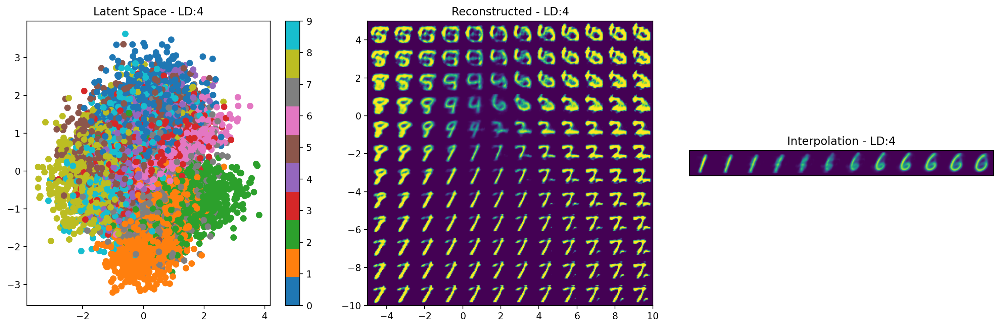

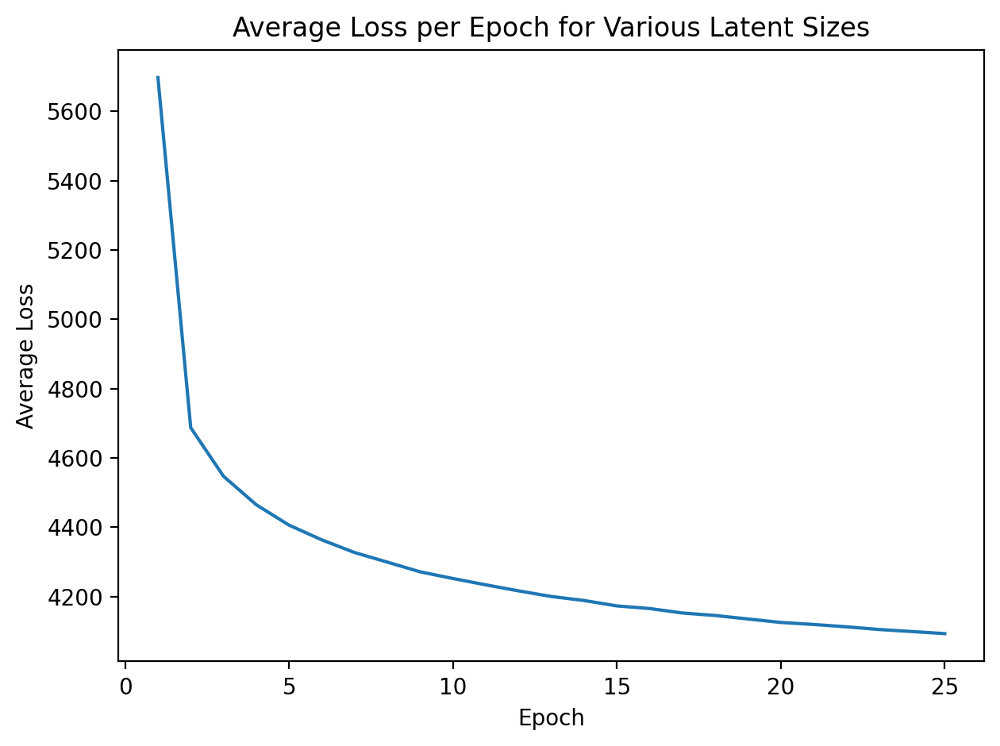

Epoch [1/25], avg_loss: 5581.5253
Epoch [2/25], avg_loss: 4407.4069
Epoch [3/25], avg_loss: 4262.6826
Epoch [4/25], avg_loss: 4183.5490
Epoch [5/25], avg_loss: 4128.0509
Epoch [6/25], avg_loss: 4083.1513
Epoch [7/25], avg_loss: 4047.1995
Epoch [8/25], avg_loss: 4013.8745
Epoch [9/25], avg_loss: 3988.7233
Epoch [10/25], avg_loss: 3964.7175
Epoch [11/25], avg_loss: 3942.2767
Epoch [12/25], avg_loss: 3923.5118
Epoch [13/25], avg_loss: 3907.3534
Epoch [14/25], avg_loss: 3892.7120
Epoch [15/25], avg_loss: 3880.1877
Epoch [16/25], avg_loss: 3869.0492
Epoch [17/25], avg_loss: 3855.0480
Epoch [18/25], avg_loss: 3846.8598
Epoch [19/25], avg_loss: 3836.6724
Epoch [20/25], avg_loss: 3829.7353
Epoch [21/25], avg_loss: 3821.2409
Epoch [22/25], avg_loss: 3816.1616
Epoch [23/25], avg_loss: 3807.7137
Epoch [24/25], avg_loss: 3803.1871
Epoch [25/25], avg_loss: 3795.8991


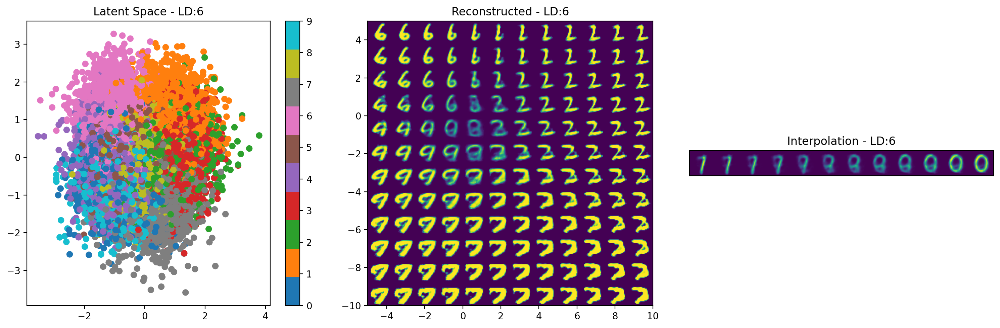

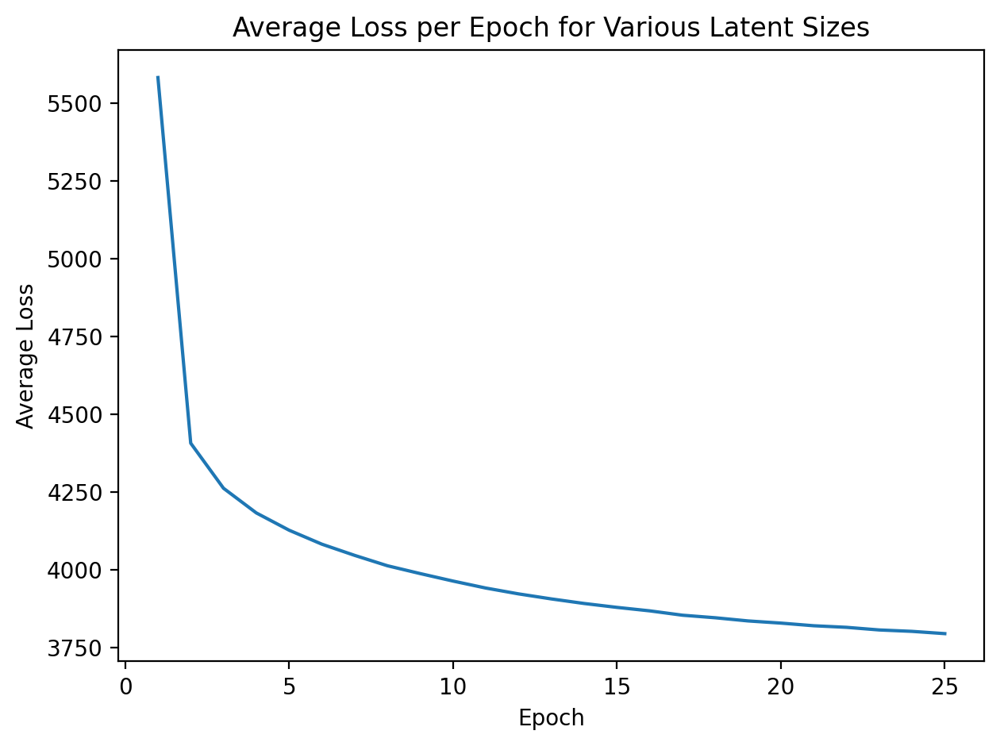

In [16]:
latent_dims_values = [2, 4, 6]
batch_size = 128
epochs = 25

for ld in latent_dims_values:
    vae = VariationalAutoencoder(ld).to(device)
    vae, avg_losses = train(vae, data, epochs=epochs)

    fig, axs = plt.subplots(1, 3, figsize=(15, 5))

    plt.sca(axs[0])
    plot_latent(vae, data)
    axs[0].set_title(f'Latent Space - LD:{ld}')

    plt.sca(axs[1])
    plot_reconstructed(vae, latent_dims=ld)
    axs[1].set_title(f'Reconstructed - LD:{ld}')

    plt.sca(axs[2])
    x, y = next(iter(data))
    x_1 = x[y == 1][0].to(device)
    x_2 = x[y == 0][0].to(device)
    interpolate(vae, x_1, x_2)
    axs[2].set_title(f'Interpolation - LD:{ld}')

    plt.tight_layout()
    plt.show()

    plt.plot(range(1, epochs+1), avg_losses, label=f"Latent Size: {ld}")

    plt.title("Average Loss per Epoch for Various Latent Sizes")
    plt.xlabel("Epoch")
    plt.ylabel("Average Loss")
    plt.tight_layout()
    plt.show()


Epoch [1/25], avg_loss: 2914.5197
Epoch [2/25], avg_loss: 2639.5419
Epoch [3/25], avg_loss: 2576.6179
Epoch [4/25], avg_loss: 2537.4522
Epoch [5/25], avg_loss: 2508.6554
Epoch [6/25], avg_loss: 2488.7489
Epoch [7/25], avg_loss: 2472.4311
Epoch [8/25], avg_loss: 2460.5159
Epoch [9/25], avg_loss: 2448.7894
Epoch [10/25], avg_loss: 2439.6674
Epoch [11/25], avg_loss: 2431.1890
Epoch [12/25], avg_loss: 2423.1345
Epoch [13/25], avg_loss: 2416.4568
Epoch [14/25], avg_loss: 2409.9323
Epoch [15/25], avg_loss: 2402.4825
Epoch [16/25], avg_loss: 2396.6353
Epoch [17/25], avg_loss: 2391.1301
Epoch [18/25], avg_loss: 2384.9719
Epoch [19/25], avg_loss: 2380.4798
Epoch [20/25], avg_loss: 2376.6827
Epoch [21/25], avg_loss: 2371.4889
Epoch [22/25], avg_loss: 2366.9380
Epoch [23/25], avg_loss: 2363.3320
Epoch [24/25], avg_loss: 2358.7487
Epoch [25/25], avg_loss: 2355.0090


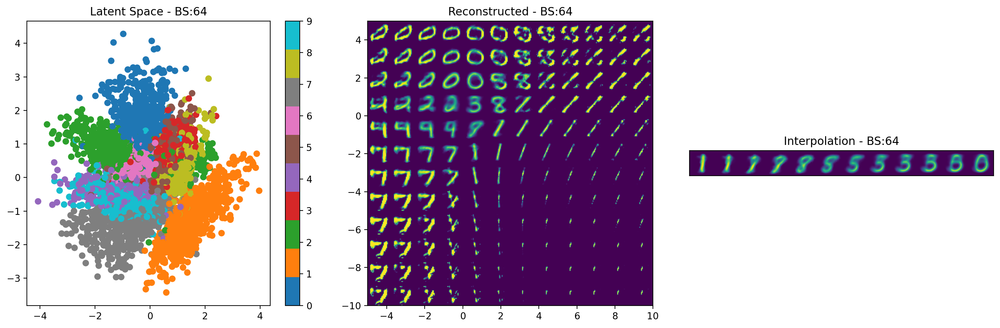

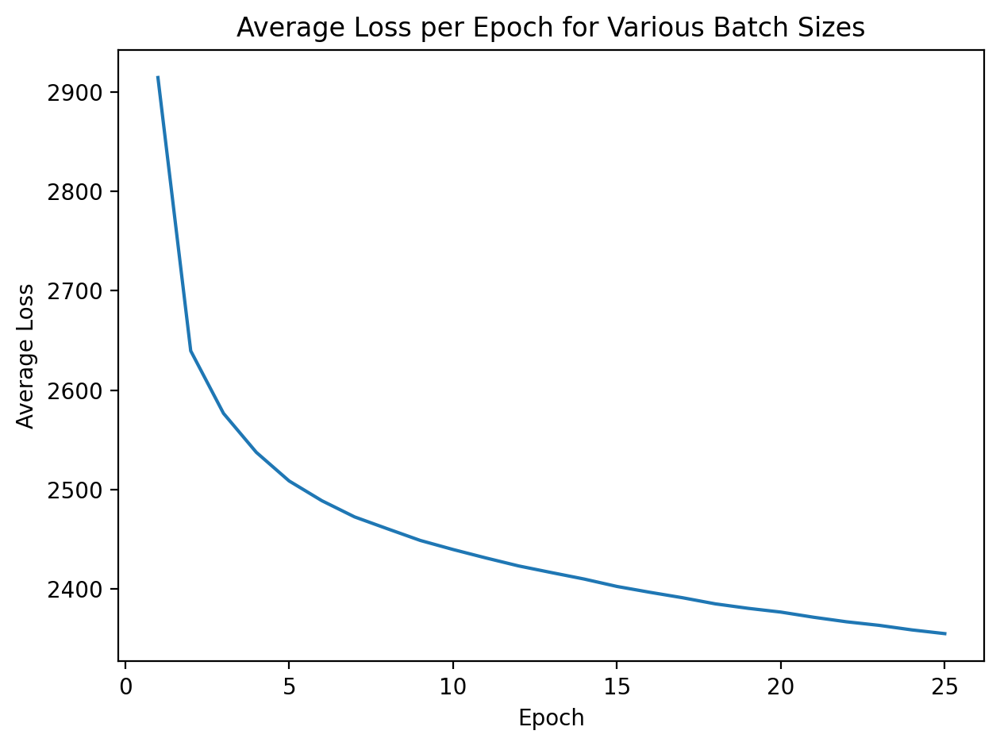

Epoch [1/25], avg_loss: 6078.4507
Epoch [2/25], avg_loss: 5333.1458
Epoch [3/25], avg_loss: 5211.2554
Epoch [4/25], avg_loss: 5134.4667
Epoch [5/25], avg_loss: 5077.3914
Epoch [6/25], avg_loss: 5032.6727
Epoch [7/25], avg_loss: 4994.8200
Epoch [8/25], avg_loss: 4962.3520
Epoch [9/25], avg_loss: 4941.7171
Epoch [10/25], avg_loss: 4915.7358
Epoch [11/25], avg_loss: 4893.9540
Epoch [12/25], avg_loss: 4874.5278
Epoch [13/25], avg_loss: 4858.3425
Epoch [14/25], avg_loss: 4843.3899
Epoch [15/25], avg_loss: 4826.2595
Epoch [16/25], avg_loss: 4808.8850
Epoch [17/25], avg_loss: 4800.4366
Epoch [18/25], avg_loss: 4787.9457
Epoch [19/25], avg_loss: 4773.8896
Epoch [20/25], avg_loss: 4762.4226
Epoch [21/25], avg_loss: 4753.0931
Epoch [22/25], avg_loss: 4738.2632
Epoch [23/25], avg_loss: 4729.5046
Epoch [24/25], avg_loss: 4722.3523
Epoch [25/25], avg_loss: 4712.8971


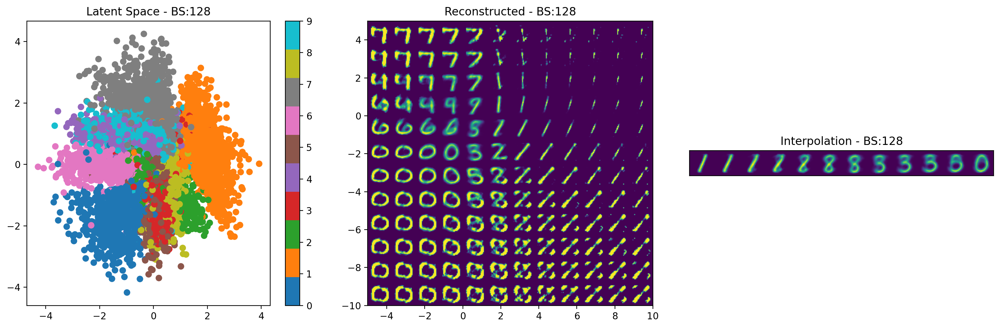

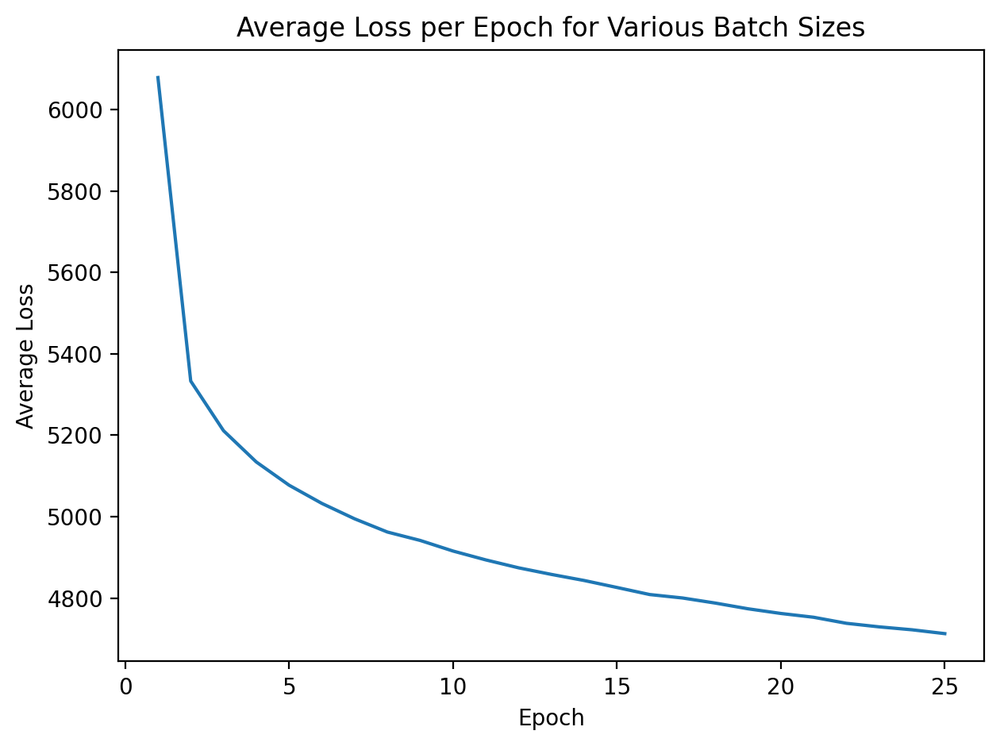

Epoch [1/25], avg_loss: 13325.3157
Epoch [2/25], avg_loss: 10997.8884
Epoch [3/25], avg_loss: 10683.8830
Epoch [4/25], avg_loss: 10520.0096
Epoch [5/25], avg_loss: 10391.2477
Epoch [6/25], avg_loss: 10283.8594
Epoch [7/25], avg_loss: 10194.1600
Epoch [8/25], avg_loss: 10117.9867
Epoch [9/25], avg_loss: 10051.3528
Epoch [10/25], avg_loss: 9996.0708
Epoch [11/25], avg_loss: 9949.9782
Epoch [12/25], avg_loss: 9907.1672
Epoch [13/25], avg_loss: 9871.0016
Epoch [14/25], avg_loss: 9833.5354
Epoch [15/25], avg_loss: 9807.8416
Epoch [16/25], avg_loss: 9772.0992
Epoch [17/25], avg_loss: 9739.5443
Epoch [18/25], avg_loss: 9721.2663
Epoch [19/25], avg_loss: 9694.8059
Epoch [20/25], avg_loss: 9673.4796
Epoch [21/25], avg_loss: 9649.0540
Epoch [22/25], avg_loss: 9632.8207
Epoch [23/25], avg_loss: 9614.0195
Epoch [24/25], avg_loss: 9592.4220
Epoch [25/25], avg_loss: 9573.5944


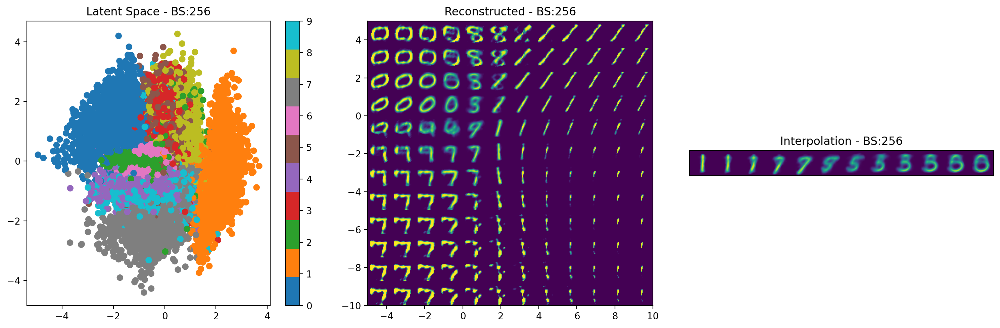

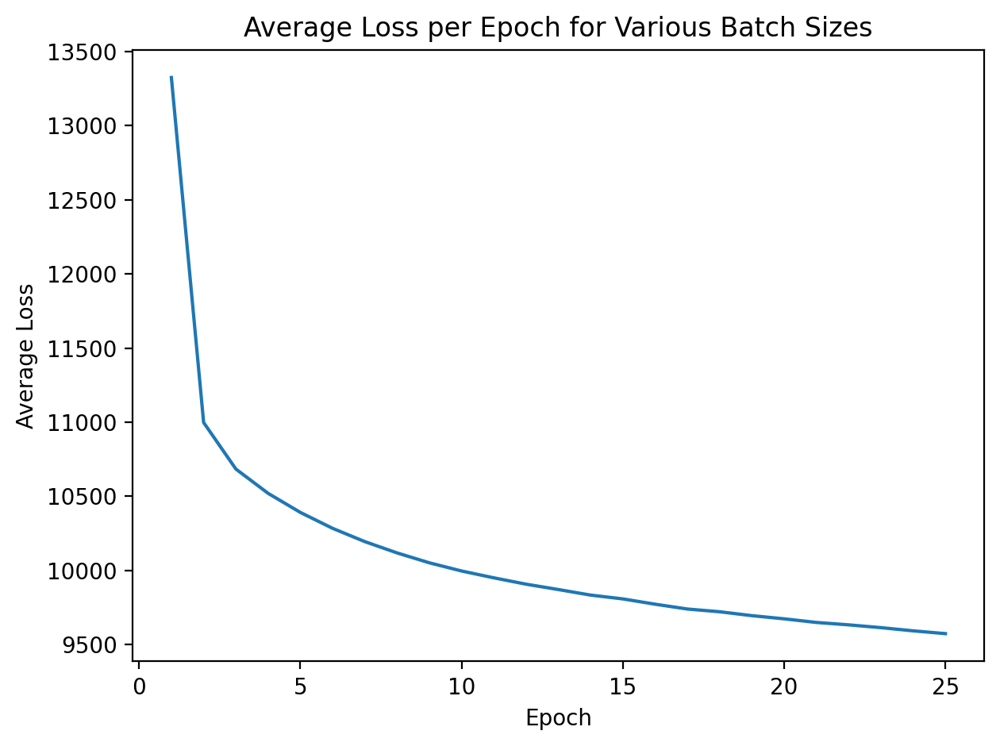

In [17]:
latent_dims = 2
batch_size_values = [64, 128, 256]
epochs = 25

for bs in batch_size_values:
    data = torch.utils.data.DataLoader(
        torchvision.datasets.MNIST('./data',
               transform=torchvision.transforms.ToTensor(),
               download=True),
        batch_size=bs,
        shuffle=True)
    
    vae = VariationalAutoencoder(latent_dims).to(device)
    vae, avg_losses = train(vae, data, epochs=epochs)

    fig, axs = plt.subplots(1, 3, figsize=(15, 5))

    plt.sca(axs[0])
    plot_latent(vae, data)
    axs[0].set_title(f'Latent Space - BS:{bs}')

    plt.sca(axs[1])
    plot_reconstructed(vae)
    axs[1].set_title(f'Reconstructed - BS:{bs}')

    plt.sca(axs[2])
    x, y = next(iter(data))
    x_1 = x[y == 1][0].to(device)
    x_2 = x[y == 0][0].to(device)
    interpolate(vae, x_1, x_2)
    axs[2].set_title(f'Interpolation - BS:{bs}')

    plt.tight_layout()
    plt.show()

    plt.plot(range(1, epochs+1), avg_losses, label=f"Batch Size: {bs}")

    plt.title("Average Loss per Epoch for Various Batch Sizes")
    plt.xlabel("Epoch")
    plt.ylabel("Average Loss")
    plt.tight_layout()
    plt.show()


Epoch [1/10], avg_loss: 13261.0600
Epoch [2/10], avg_loss: 11056.4694
Epoch [3/10], avg_loss: 10774.8341
Epoch [4/10], avg_loss: 10614.3520
Epoch [5/10], avg_loss: 10485.2263
Epoch [6/10], avg_loss: 10380.8149
Epoch [7/10], avg_loss: 10295.7004
Epoch [8/10], avg_loss: 10215.0058
Epoch [9/10], avg_loss: 10137.5575
Epoch [10/10], avg_loss: 10074.9398


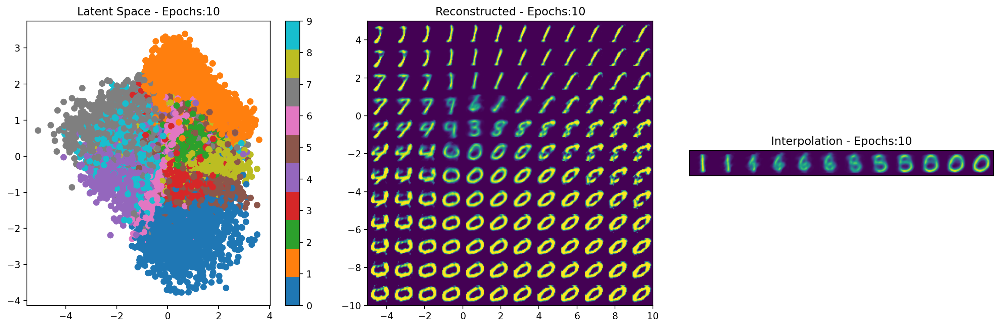

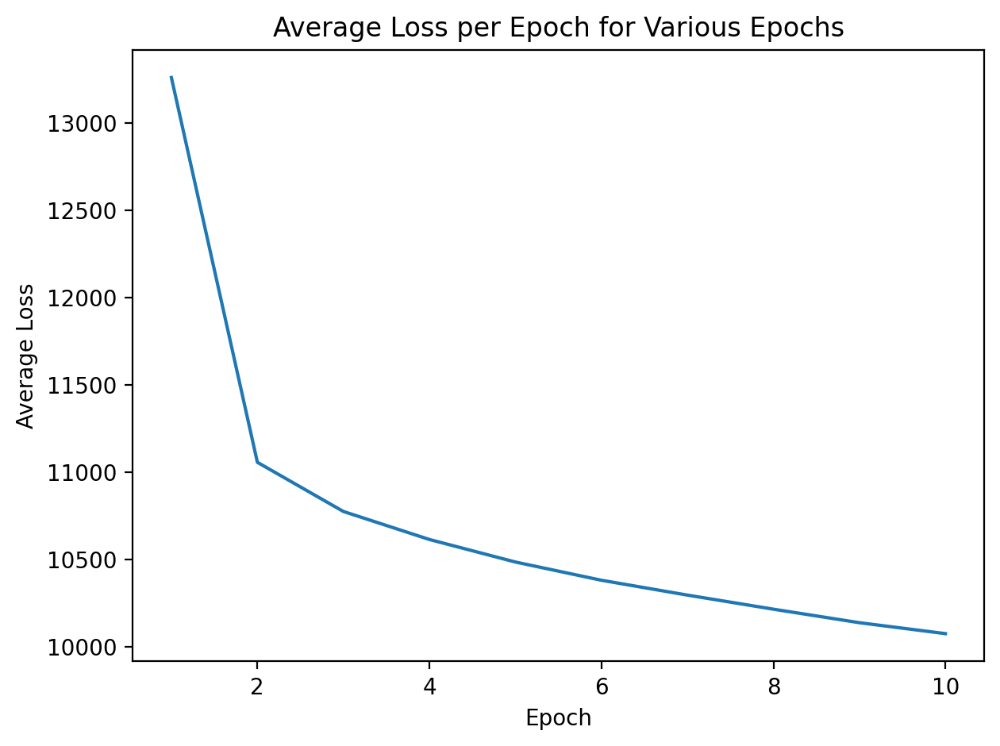

Epoch [1/25], avg_loss: 13131.3794
Epoch [2/25], avg_loss: 11126.7753
Epoch [3/25], avg_loss: 10756.5903
Epoch [4/25], avg_loss: 10518.9712
Epoch [5/25], avg_loss: 10370.2821
Epoch [6/25], avg_loss: 10266.5754
Epoch [7/25], avg_loss: 10183.5608
Epoch [8/25], avg_loss: 10119.0428
Epoch [9/25], avg_loss: 10058.6153
Epoch [10/25], avg_loss: 9997.2343
Epoch [11/25], avg_loss: 9957.6932
Epoch [12/25], avg_loss: 9910.0017
Epoch [13/25], avg_loss: 9876.1714
Epoch [14/25], avg_loss: 9842.1091
Epoch [15/25], avg_loss: 9812.4079
Epoch [16/25], avg_loss: 9777.0064
Epoch [17/25], avg_loss: 9756.2951
Epoch [18/25], avg_loss: 9726.5304
Epoch [19/25], avg_loss: 9701.0706
Epoch [20/25], avg_loss: 9684.1614
Epoch [21/25], avg_loss: 9662.2765
Epoch [22/25], avg_loss: 9641.7148
Epoch [23/25], avg_loss: 9624.8089
Epoch [24/25], avg_loss: 9610.8221
Epoch [25/25], avg_loss: 9591.1001


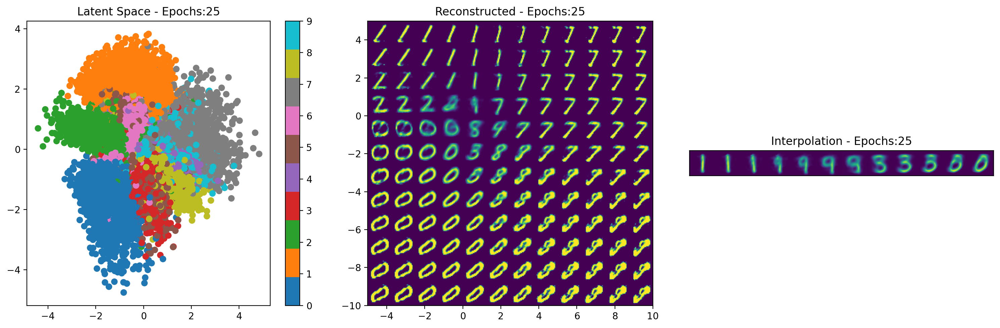

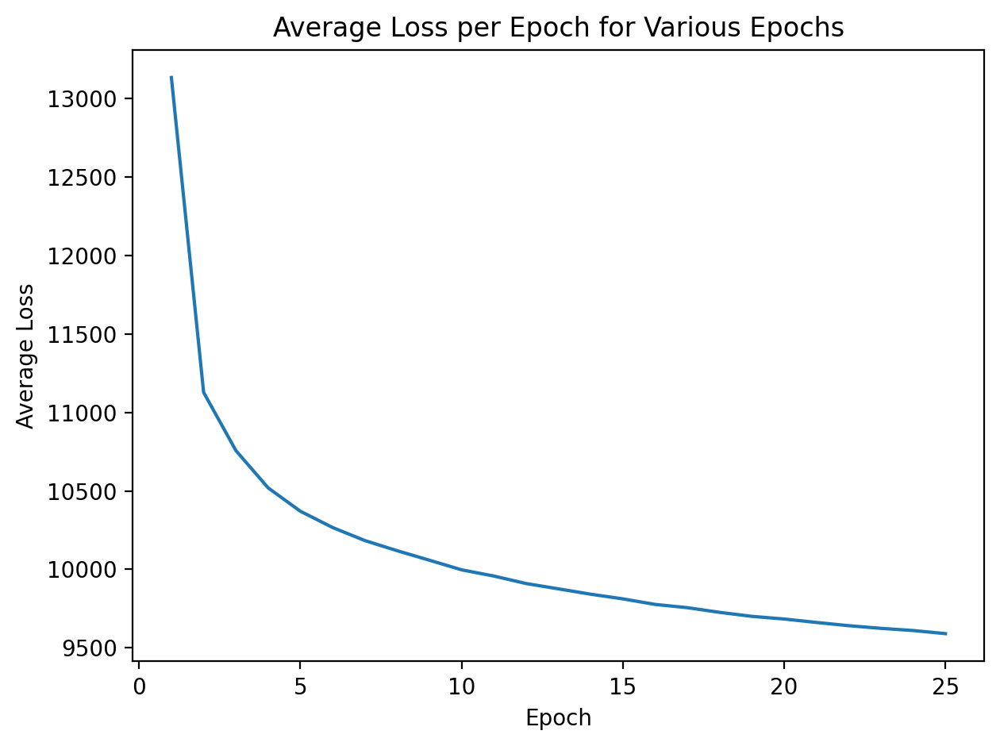

Epoch [1/30], avg_loss: 13450.9802
Epoch [2/30], avg_loss: 11122.9921
Epoch [3/30], avg_loss: 10776.9278
Epoch [4/30], avg_loss: 10603.3752
Epoch [5/30], avg_loss: 10479.8206
Epoch [6/30], avg_loss: 10377.5263
Epoch [7/30], avg_loss: 10296.6603
Epoch [8/30], avg_loss: 10214.5343
Epoch [9/30], avg_loss: 10146.8707
Epoch [10/30], avg_loss: 10096.2216
Epoch [11/30], avg_loss: 10041.7505
Epoch [12/30], avg_loss: 9994.4682
Epoch [13/30], avg_loss: 9955.1964
Epoch [14/30], avg_loss: 9920.2400
Epoch [15/30], avg_loss: 9881.7642
Epoch [16/30], avg_loss: 9854.7346
Epoch [17/30], avg_loss: 9819.6108
Epoch [18/30], avg_loss: 9790.1991
Epoch [19/30], avg_loss: 9761.6956
Epoch [20/30], avg_loss: 9749.5551
Epoch [21/30], avg_loss: 9714.6032
Epoch [22/30], avg_loss: 9699.8114
Epoch [23/30], avg_loss: 9671.0784
Epoch [24/30], avg_loss: 9654.8503
Epoch [25/30], avg_loss: 9635.3328
Epoch [26/30], avg_loss: 9619.8604
Epoch [27/30], avg_loss: 9609.0665
Epoch [28/30], avg_loss: 9589.7658
Epoch [29/30], avg

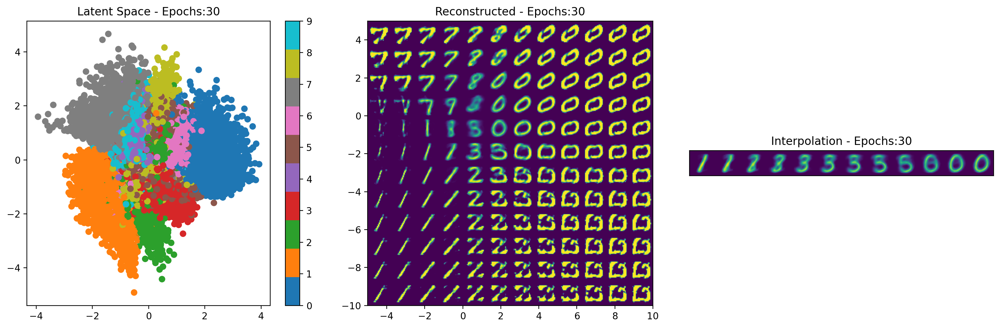

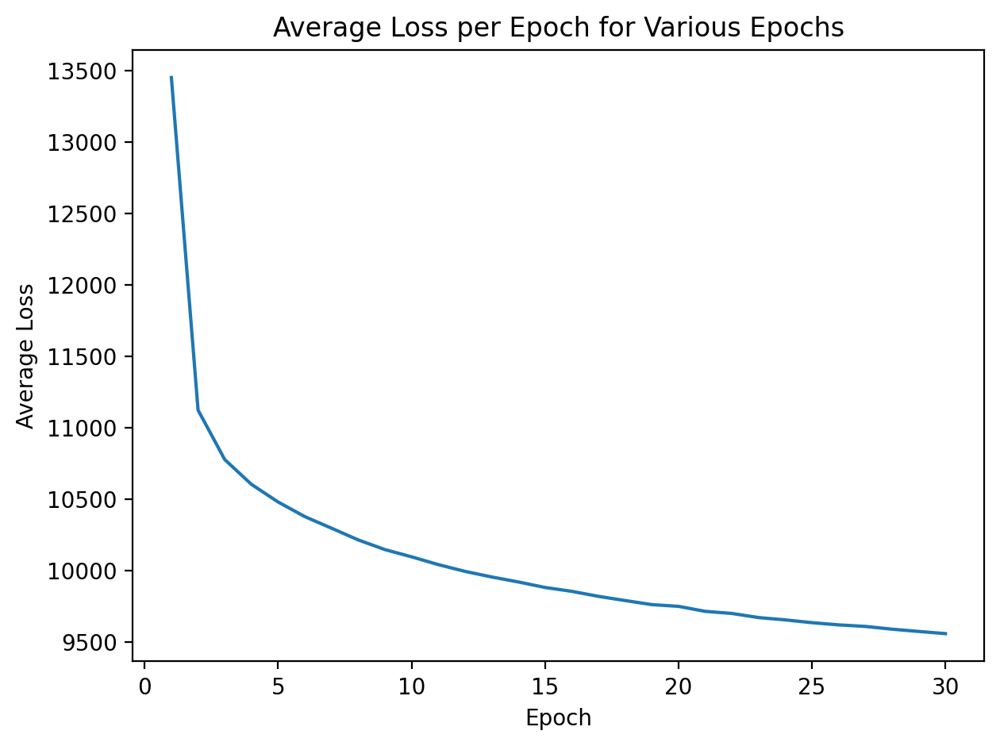

In [21]:
latent_dims = 2
batch_size = 128
epochs_values = [10, 25, 30]

for ep in epochs_values:
    vae = VariationalAutoencoder(latent_dims).to(device)
    vae, avg_losses = train(vae, data, epochs=ep)

    fig, axs = plt.subplots(1, 3, figsize=(15, 5))


    plt.sca(axs[0])
    plot_latent(vae, data)
    axs[0].set_title(f'Latent Space - Epochs:{ep}')

    plt.sca(axs[1])
    plot_reconstructed(vae)
    axs[1].set_title(f'Reconstructed - Epochs:{ep}')

    plt.sca(axs[2])
    x, y = next(iter(data))
    x_1 = x[y == 1][0].to(device)
    x_2 = x[y == 0][0].to(device)
    interpolate(vae, x_1, x_2)
    axs[2].set_title(f'Interpolation - Epochs:{ep}')

    plt.tight_layout()
    plt.show()

    plt.plot(range(1, ep+1), avg_losses, label=f"Epochs: {ep}")

    plt.title("Average Loss per Epoch for Various Epochs")
    plt.xlabel("Epoch")
    plt.ylabel("Average Loss")
    plt.tight_layout()
    plt.show()

    

Epoch [1/25], avg_loss: 8572.1991
Epoch [2/25], avg_loss: 6668.9237
Epoch [3/25], avg_loss: 6240.3425
Epoch [4/25], avg_loss: 6011.0531
Epoch [5/25], avg_loss: 5808.8386
Epoch [6/25], avg_loss: 5678.3863
Epoch [7/25], avg_loss: 5598.8414
Epoch [8/25], avg_loss: 5543.7501
Epoch [9/25], avg_loss: 5498.6530
Epoch [10/25], avg_loss: 5461.6957
Epoch [11/25], avg_loss: 5429.2317
Epoch [12/25], avg_loss: 5400.0872
Epoch [13/25], avg_loss: 5374.3589
Epoch [14/25], avg_loss: 5350.0626
Epoch [15/25], avg_loss: 5329.4753
Epoch [16/25], avg_loss: 5305.6504
Epoch [17/25], avg_loss: 5284.3304
Epoch [18/25], avg_loss: 5264.7102
Epoch [19/25], avg_loss: 5244.7426
Epoch [20/25], avg_loss: 5226.0124
Epoch [21/25], avg_loss: 5208.7059
Epoch [22/25], avg_loss: 5191.7772
Epoch [23/25], avg_loss: 5173.8083
Epoch [24/25], avg_loss: 5158.8423
Epoch [25/25], avg_loss: 5144.4876


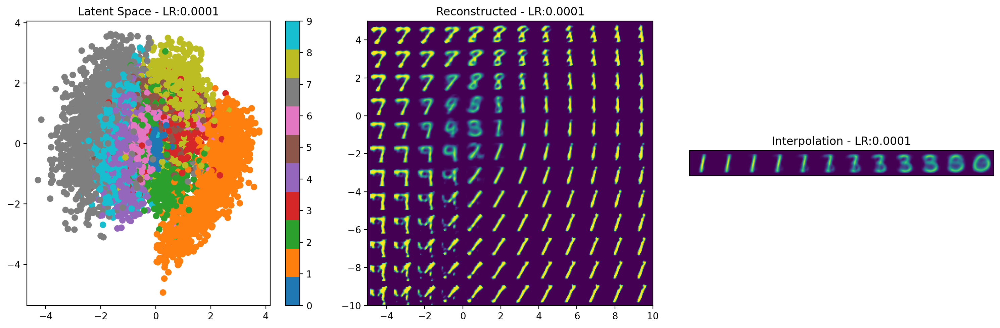

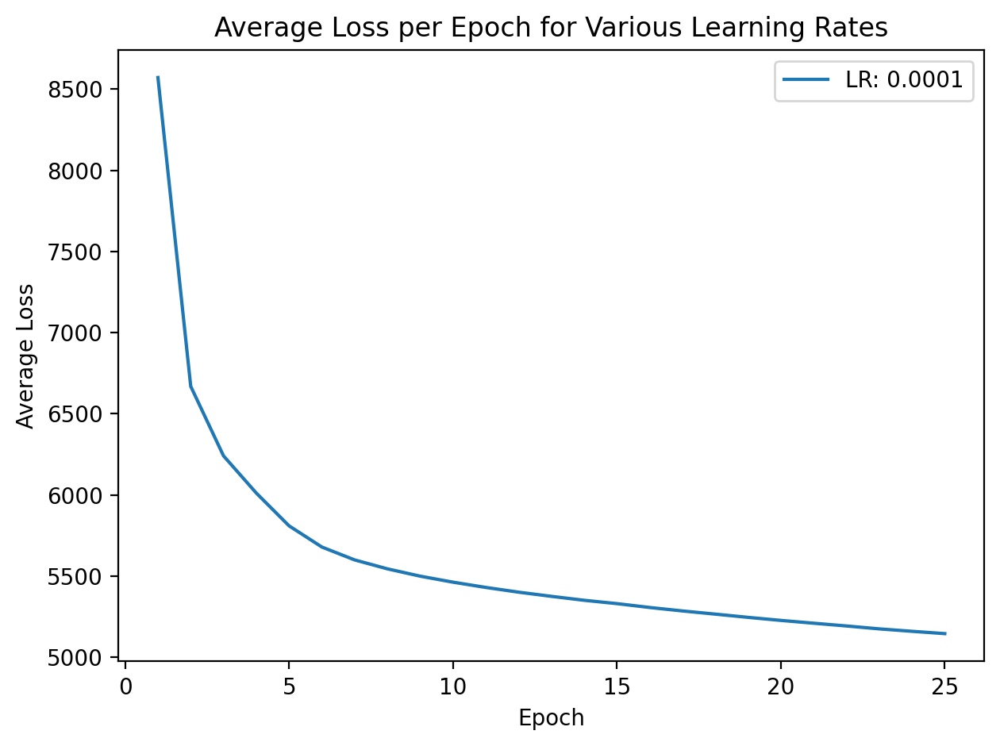

Epoch [1/25], avg_loss: 6044.9402
Epoch [2/25], avg_loss: 5327.8059
Epoch [3/25], avg_loss: 5209.8571
Epoch [4/25], avg_loss: 5132.3689
Epoch [5/25], avg_loss: 5073.0605
Epoch [6/25], avg_loss: 5027.1198
Epoch [7/25], avg_loss: 4986.0106
Epoch [8/25], avg_loss: 4953.3417
Epoch [9/25], avg_loss: 4929.6555
Epoch [10/25], avg_loss: 4902.4631
Epoch [11/25], avg_loss: 4884.6134
Epoch [12/25], avg_loss: 4858.9705
Epoch [13/25], avg_loss: 4843.3991
Epoch [14/25], avg_loss: 4828.3146
Epoch [15/25], avg_loss: 4809.2480
Epoch [16/25], avg_loss: 4796.6939
Epoch [17/25], avg_loss: 4782.0060
Epoch [18/25], avg_loss: 4769.7372
Epoch [19/25], avg_loss: 4755.1827
Epoch [20/25], avg_loss: 4744.1399
Epoch [21/25], avg_loss: 4733.4998
Epoch [22/25], avg_loss: 4722.6829
Epoch [23/25], avg_loss: 4714.4578
Epoch [24/25], avg_loss: 4702.6494
Epoch [25/25], avg_loss: 4692.2981


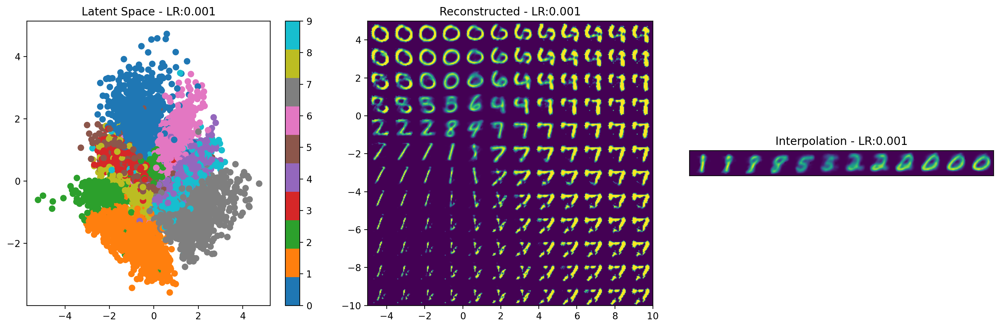

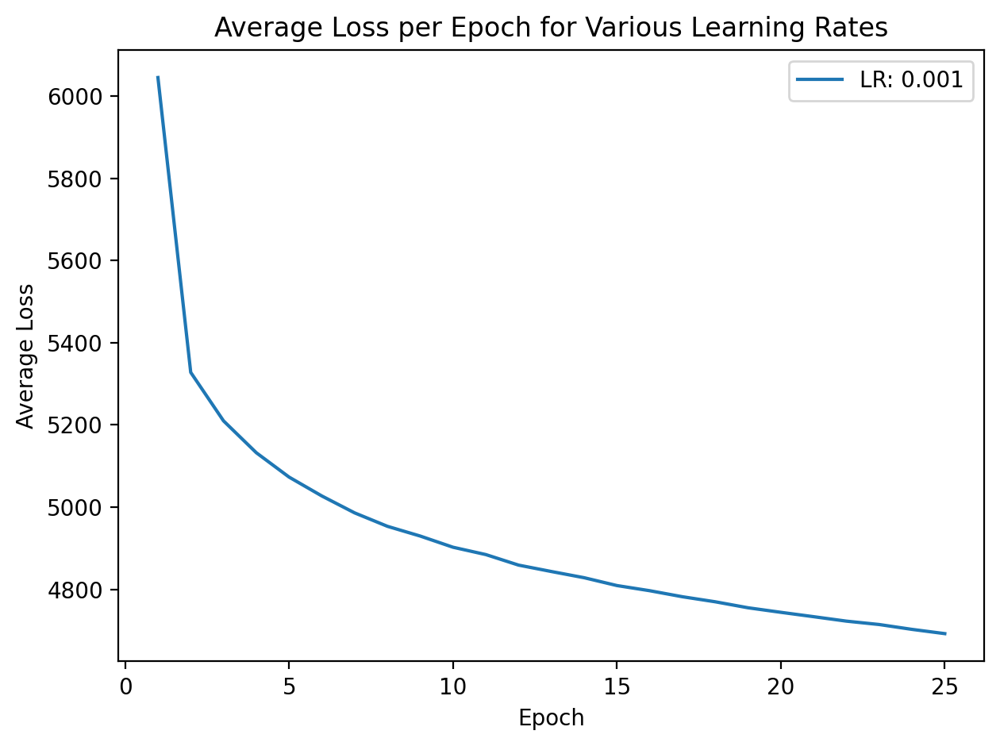

Epoch [1/25], avg_loss: 5649.1618
Epoch [2/25], avg_loss: 5211.6131
Epoch [3/25], avg_loss: 5133.0616
Epoch [4/25], avg_loss: 5092.7910
Epoch [5/25], avg_loss: 5065.7821
Epoch [6/25], avg_loss: 5046.2148
Epoch [7/25], avg_loss: 5025.0352
Epoch [8/25], avg_loss: 5009.4357
Epoch [9/25], avg_loss: 5003.6289
Epoch [10/25], avg_loss: 4990.1011
Epoch [11/25], avg_loss: 4974.1886
Epoch [12/25], avg_loss: 4973.4840
Epoch [13/25], avg_loss: 4963.9456
Epoch [14/25], avg_loss: 4953.2002
Epoch [15/25], avg_loss: 4956.0480
Epoch [16/25], avg_loss: 4937.1720
Epoch [17/25], avg_loss: 4936.8162
Epoch [18/25], avg_loss: 4932.1110
Epoch [19/25], avg_loss: 4924.1293
Epoch [20/25], avg_loss: 4917.0546
Epoch [21/25], avg_loss: 4922.1916
Epoch [22/25], avg_loss: 4918.1948
Epoch [23/25], avg_loss: 4907.9698
Epoch [24/25], avg_loss: 4904.6495
Epoch [25/25], avg_loss: 4899.6674


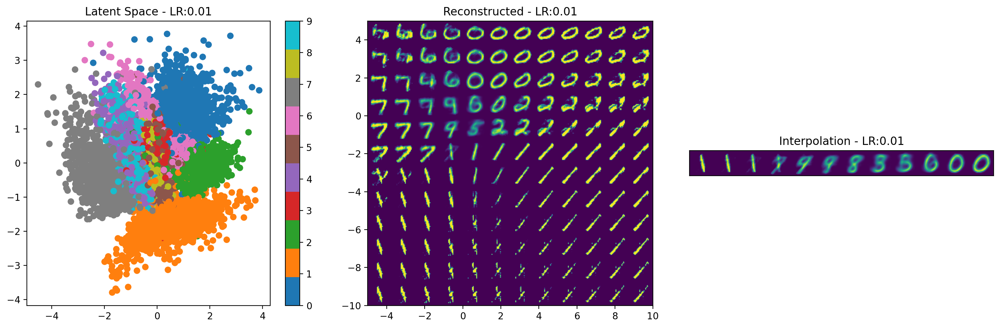

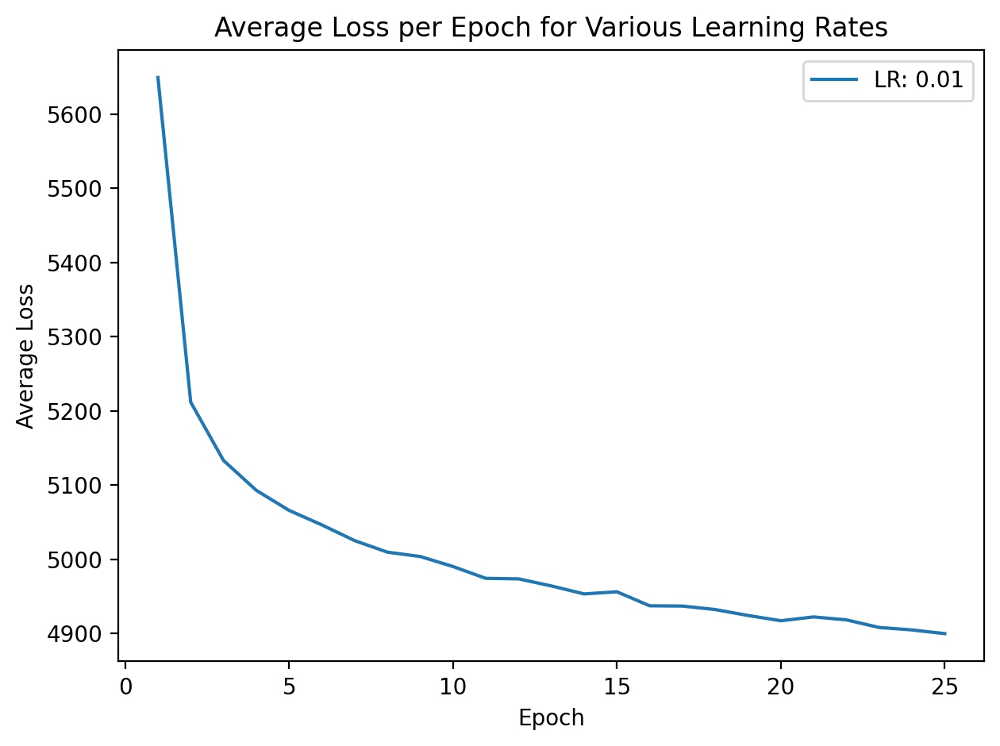

In [17]:
latent_dims = 2
batch_size = 128
learning_rates = [0.0001, 0.001, 0.01]
epochs = 25

for lr in learning_rates:
    vae = VariationalAutoencoder(latent_dims).to(device)
    vae, avg_losses = train(vae, data, epochs=epochs, learning_rate=lr)

    fig, axs = plt.subplots(1, 3, figsize=(15, 5))

    plt.sca(axs[0])
    plot_latent(vae, data)
    axs[0].set_title(f'Latent Space - LR:{lr}')

    plt.sca(axs[1])
    plot_reconstructed(vae)
    axs[1].set_title(f'Reconstructed - LR:{lr}')

    plt.sca(axs[2])
    x, y = next(iter(data))
    x_1 = x[y == 1][0].to(device)
    x_2 = x[y == 0][0].to(device)
    interpolate(vae, x_1, x_2)
    axs[2].set_title(f'Interpolation - LR:{lr}')

    plt.tight_layout()
    plt.show()

    plt.plot(range(1, epochs+1), avg_losses, label=f"LR: {lr}")

    plt.title("Average Loss per Epoch for Various Learning Rates")
    plt.xlabel("Epoch")
    plt.ylabel("Average Loss")
    plt.legend()
    plt.tight_layout()
    plt.show()


Zadanie 3,4

In [7]:
class Encoder(nn.Module):
    def __init__(self, latent_dims):
        super(Encoder, self).__init__()
        self.linear1 = nn.Linear(784, 512)
        self.linear2 = nn.Linear(512, latent_dims)

    def forward(self, x):
        x = torch.flatten(x, start_dim=1)
        x = F.relu(self.linear1(x))
        z = self.linear2(x)
        return z

class Autoencoder(nn.Module):
    def __init__(self, latent_dims):
        super(Autoencoder, self).__init__()
        self.encoder = Encoder(latent_dims)
        self.decoder = Decoder(latent_dims)

    def forward(self, x):
        z = self.encoder(x)
        return self.decoder(z)


Zadanie 5

In [11]:
def train(autoencoder, data, epochs, learning_rate=0.001):
    optimizer = torch.optim.Adam(autoencoder.parameters(), lr=learning_rate)
    criterion = nn.MSELoss()

    losses = []
    for epoch in range(epochs):
        epoch_loss = 0
        for batch in data:
            x, _ = batch
            x = x.to(device)
            
            optimizer.zero_grad()
            reconstructed = autoencoder(x)
            loss = criterion(reconstructed, x)
            loss.backward()
            optimizer.step()
            
            epoch_loss += loss.item()

        average_epoch_loss = epoch_loss / len(data)
        losses.append(average_epoch_loss)
        print(f"Epoch {epoch+1}/{epochs} - Loss: {average_epoch_loss:.4f}")
    filename = 'autoencoder.sav'
    pickle.dump(autoencoder, open(filename, 'wb'))
        
    return autoencoder, losses


Zadanie 6

In [12]:
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

latent_dims = 2
learning_rate = 0.001

autoencoder = Autoencoder(latent_dims).to(device)
autoencoder, avg_losses = train(autoencoder, data, epochs=25, learning_rate=learning_rate)

Epoch 1/25 - Loss: 0.0556
Epoch 2/25 - Loss: 0.0473
Epoch 3/25 - Loss: 0.0455
Epoch 4/25 - Loss: 0.0444
Epoch 5/25 - Loss: 0.0435
Epoch 6/25 - Loss: 0.0429
Epoch 7/25 - Loss: 0.0424
Epoch 8/25 - Loss: 0.0420
Epoch 9/25 - Loss: 0.0416
Epoch 10/25 - Loss: 0.0412
Epoch 11/25 - Loss: 0.0409
Epoch 12/25 - Loss: 0.0406
Epoch 13/25 - Loss: 0.0404
Epoch 14/25 - Loss: 0.0402
Epoch 15/25 - Loss: 0.0399
Epoch 16/25 - Loss: 0.0398
Epoch 17/25 - Loss: 0.0396
Epoch 18/25 - Loss: 0.0394
Epoch 19/25 - Loss: 0.0393
Epoch 20/25 - Loss: 0.0391
Epoch 21/25 - Loss: 0.0390
Epoch 22/25 - Loss: 0.0388
Epoch 23/25 - Loss: 0.0387
Epoch 24/25 - Loss: 0.0386
Epoch 25/25 - Loss: 0.0385


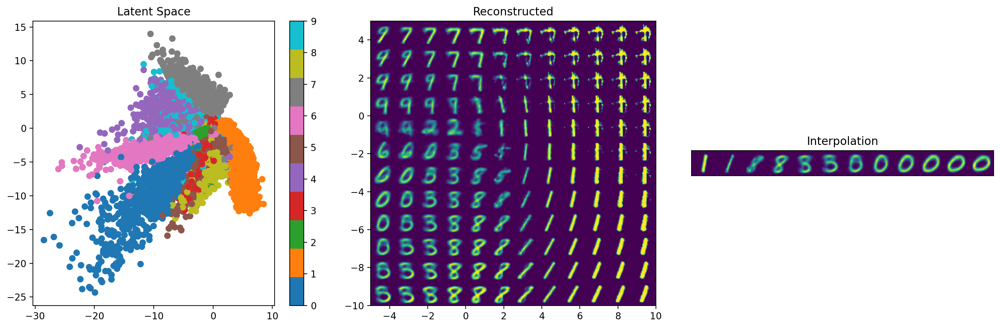

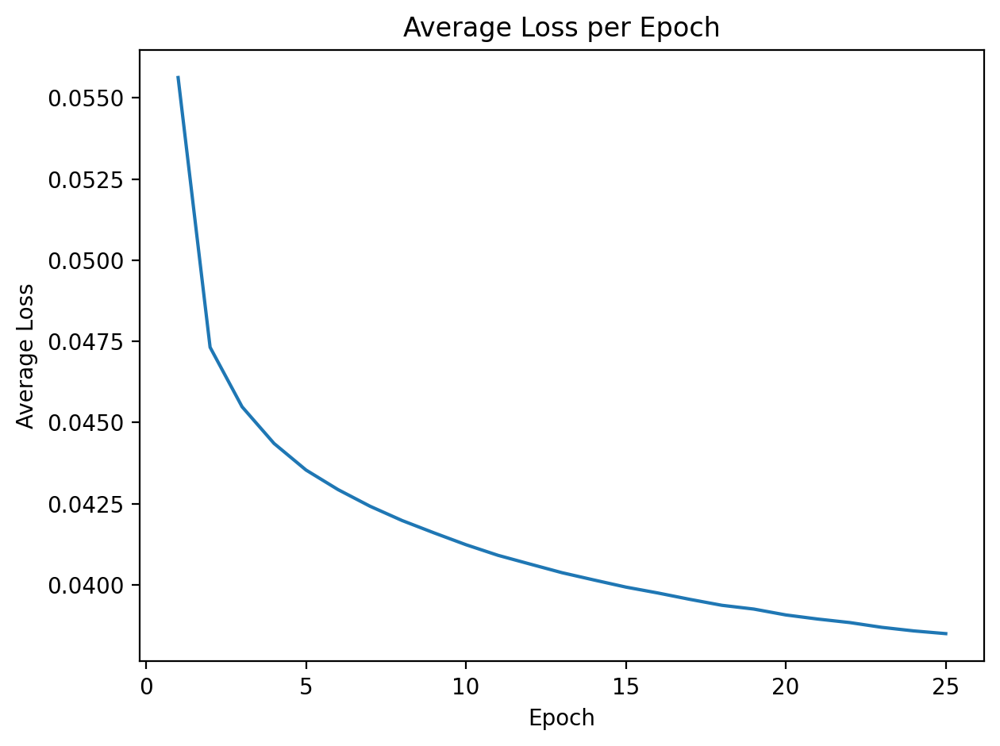

In [18]:
fig, axs = plt.subplots(1, 3, figsize=(15, 5))

plt.sca(axs[0])
plot_latent(autoencoder, data)
axs[0].set_title(f'Latent Space')

plt.sca(axs[1])
plot_reconstructed(autoencoder)
axs[1].set_title(f'Reconstructed')

plt.sca(axs[2])
x, y = next(iter(data))
x_1 = x[y == 1][0].to(device)
x_2 = x[y == 0][0].to(device)
interpolate(autoencoder, x_1, x_2)
axs[2].set_title(f'Interpolation')

plt.tight_layout()
plt.show()

plt.plot(range(1, len(avg_losses) + 1), avg_losses)
plt.title("Average Loss per Epoch")
plt.xlabel("Epoch")
plt.ylabel("Average Loss")
plt.tight_layout()
plt.show()


Zadanie 7

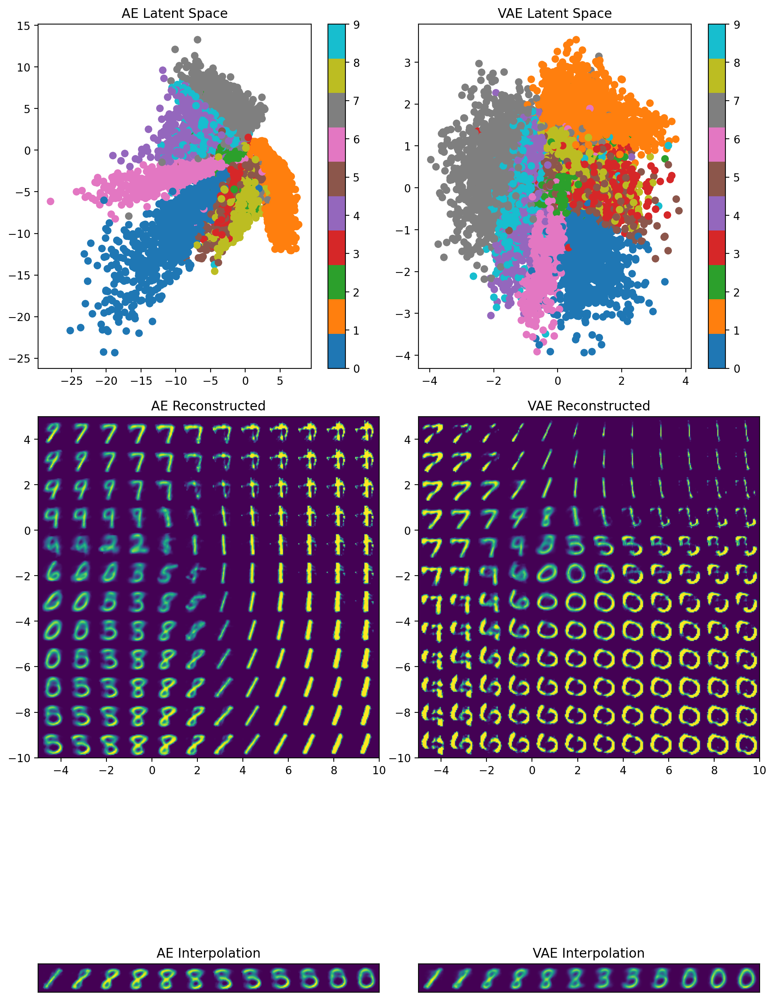

In [23]:
vae = pickle.load(open('vae.sav', 'rb'))
autoencoder = pickle.load(open('autoencoder.sav', 'rb'))

def compare_models(autoencoder, vae, data):
    fig, axs = plt.subplots(3, 2, figsize=(10, 15))

    plt.sca(axs[0, 0])
    plot_latent(autoencoder, data)
    axs[0, 0].set_title('AE Latent Space')
    
    plt.sca(axs[0, 1])
    plot_latent(vae, data)
    axs[0, 1].set_title('VAE Latent Space')

    plt.sca(axs[1, 0])
    plot_reconstructed(autoencoder)
    axs[1, 0].set_title('AE Reconstructed')
    
    plt.sca(axs[1, 1])
    plot_reconstructed(vae)
    axs[1, 1].set_title('VAE Reconstructed')

    x, y = next(iter(data))
    x_1 = x[y == 1][0].to(device)
    x_2 = x[y == 0][0].to(device)

    plt.sca(axs[2, 0])
    interpolate(autoencoder, x_1, x_2)
    axs[2, 0].set_title('AE Interpolation')

    plt.sca(axs[2, 1])
    interpolate(vae, x_1, x_2)
    axs[2, 1].set_title('VAE Interpolation')

    plt.tight_layout()
    plt.show()

compare_models(autoencoder, vae, data)

Zadanie 8

Concrete VAE

In [26]:
BATCH_SIZE = 128
EPOCHS = 25
USE_CUDA = torch.cuda.is_available()
SEED = 1
LOG_INTERVAL = 10
INITIAL_TEMP = 1.0
ANNEAL_RATE = 0.00003
MIN_TEMP = 0.1
K = 10 
N = 20  

temp = INITIAL_TEMP
steps = 0


class Concrete_VAE(nn.Module):
    def __init__(self):
        super(Concrete_VAE, self).__init__()

        self.fc1 = nn.Linear(784, 400)
        self.fc2 = nn.Linear(400, N*K)
        self.fc3 = nn.Linear(N*K, 400)
        self.fc4 = nn.Linear(400, 784)

    def encoder(self, x):
        h1 = F.relu(self.fc1(x))
        return self.fc2(h1).reshape(-1, N, K)

    def decoder(self, z):
        h3 = F.relu(self.fc3(z.view(-1, N*K)))
        return torch.sigmoid(self.fc4(h3))

    def forward(self, x, temp=1.0, hard=False):
        logits = self.encoder(x.view(-1, 784))
        q_z = td.relaxed_categorical.RelaxedOneHotCategorical(temp, logits=logits)
        probs = q_z.probs
        z = q_z.rsample()

        if hard:
            z_hard = 0.5 * (torch.sign(z) + 1)
            z = z + (z_hard - z).detach()

        return self.decoder(z), probs

concretevae = Concrete_VAE().to(device)
optimizer = optim.Adam(concretevae.parameters(), lr=1e-3)

def loss_function(recon_x, x, probs, eps=1e-10):
    MSE = F.mse_loss(recon_x, x.view(-1, 784), reduction='sum')

    prior = 1 / K
    t1 = probs * ((probs + eps) / prior).log()
    KLD = torch.sum(t1, dim=-1).sum()

    return MSE + KLD

def train(model, train_loader, epochs=EPOCHS, learning_rate=1e-3):
    optimizer = torch.optim.Adam(model.parameters(), lr=learning_rate)
    avg_losses = []

    for epoch in range(epochs):
        loss_list = []
        for data, _ in train_loader:
            data = data.to(device)
            optimizer.zero_grad()
            recon_batch, q_z = model(data, temp=temp)
            loss = loss_function(recon_batch, data, q_z)
            loss.backward()
            optimizer.step()
            loss_list.append(loss.item())

        avg_loss = np.mean(loss_list)
        avg_losses.append(avg_loss)
        print(f"Epoch [{epoch+1}/{epochs}], avg_loss: {avg_loss:.4f}")
    filename = 'concretevae.sav'
    pickle.dump(model, open(filename, 'wb'))

    return model, avg_losses

In [8]:
concretevae, avg_losses = train(concretevae, data)

Epoch [1/25], avg_loss: 6783.6112
Epoch [2/25], avg_loss: 5199.7704
Epoch [3/25], avg_loss: 4600.8010
Epoch [4/25], avg_loss: 4221.5608
Epoch [5/25], avg_loss: 3973.4212
Epoch [6/25], avg_loss: 3819.9114
Epoch [7/25], avg_loss: 3696.6463
Epoch [8/25], avg_loss: 3598.1561
Epoch [9/25], avg_loss: 3522.4888
Epoch [10/25], avg_loss: 3458.9866
Epoch [11/25], avg_loss: 3405.1657
Epoch [12/25], avg_loss: 3360.9230
Epoch [13/25], avg_loss: 3322.6118
Epoch [14/25], avg_loss: 3292.0758
Epoch [15/25], avg_loss: 3264.0867
Epoch [16/25], avg_loss: 3238.5287
Epoch [17/25], avg_loss: 3217.9644
Epoch [18/25], avg_loss: 3200.1424
Epoch [19/25], avg_loss: 3185.5858
Epoch [20/25], avg_loss: 3171.8832
Epoch [21/25], avg_loss: 3159.7224
Epoch [22/25], avg_loss: 3145.5108
Epoch [23/25], avg_loss: 3134.3452
Epoch [24/25], avg_loss: 3124.5960
Epoch [25/25], avg_loss: 3113.9304


In [9]:
def plot_latent(autoencoder, data, num_batches=100):
    for i, (x, y) in enumerate(data):
        x = x.view(-1, 784).to(device)
        z = autoencoder.encoder(x)
        z = z.to('cpu').detach().numpy()
        z_dim = z[:, :, 0]
        plt.scatter(z_dim[:, 0], z_dim[:, 1], c=y, cmap='tab10')

In [21]:
def plot_reconstructed(autoencoder, latent_dim, dims=(0, 1), r0=(-5, 10), r1=(-10, 5), n=12):
    w = 28
    img = np.zeros((n*w, n*w))
    
    for i, y in enumerate(np.linspace(*r1, n)):
        for j, x in enumerate(np.linspace(*r0, n)):
            sample = torch.zeros(1, latent_dim)
            
            sample[0, dims[0]] = x
            sample[0, dims[1]] = y

            z = sample.to(device)
            x_hat = autoencoder.decoder(z)
            x_hat = x_hat.reshape(28, 28).to('cpu').detach().numpy()
            img[(n-1-i)*w:(n-1-i+1)*w, j*w:(j+1)*w] = x_hat
    
    plt.imshow(img, extent=[*r0, *r1])
    plt.xlabel(f"Latent dimension {dims[0]}")
    plt.ylabel(f"Latent dimension {dims[1]}")


In [11]:
def interpolate(autoencoder, x_1, x_2, n=12):
    x_1 = x_1.view(-1, 784)
    x_2 = x_2.view(-1, 784)
    
    z_1 = autoencoder.encoder(x_1)
    z_2 = autoencoder.encoder(x_2)
    z = torch.stack([z_1 + (z_2 - z_1)*t for t in np.linspace(0, 1, n)])
    interpolate_list = autoencoder.decoder(z)
    interpolate_list = interpolate_list.to('cpu').detach().numpy()

    w = 28
    img = np.zeros((w, n*w))
    for i, x_hat in enumerate(interpolate_list):
        img[:, i*w:(i+1)*w] = x_hat.reshape(28, 28)
    plt.imshow(img)
    plt.xticks([])
    plt.yticks([])


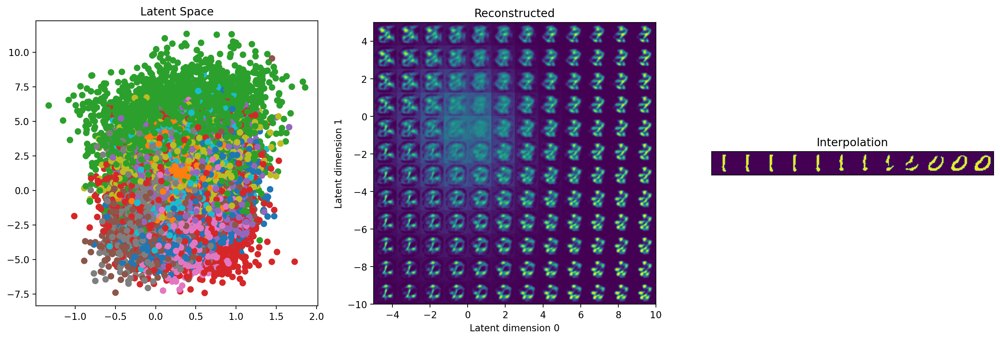

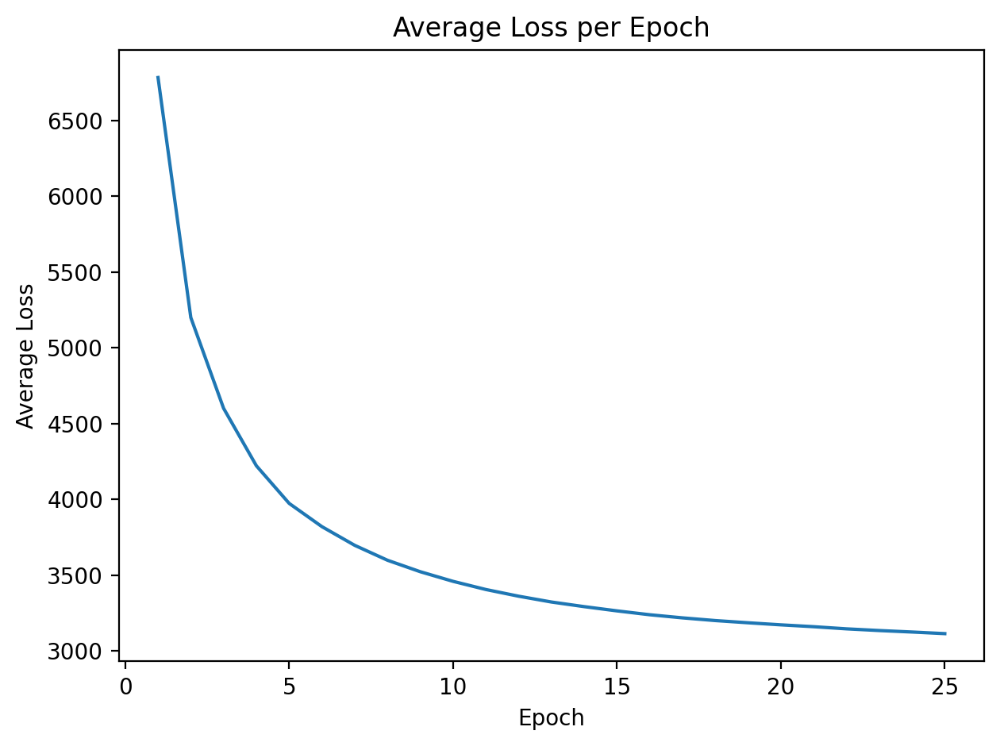

In [13]:
fig, axs = plt.subplots(1, 3, figsize=(15, 5))

plt.sca(axs[0])
plot_latent(concretevae, data)
axs[0].set_title(f'Latent Space')

plt.sca(axs[1])
latent_dim = N*K
plot_reconstructed(concretevae, latent_dim=latent_dim)
axs[1].set_title(f'Reconstructed')

plt.sca(axs[2])
x, y = next(iter(data))
x_1 = x[y == 1][0].to(device)
x_2 = x[y == 0][0].to(device)
interpolate(concretevae, x_1, x_2)
axs[2].set_title(f'Interpolation')

plt.tight_layout()
plt.show()

plt.plot(range(1, len(avg_losses) + 1), avg_losses)
plt.title("Average Loss per Epoch")
plt.xlabel("Epoch")
plt.ylabel("Average Loss")
plt.tight_layout()
plt.show()

Beta VAE

In [16]:
class BetaVariationalEncoder(VariationalEncoder):
    def __init__(self, latent_dims, beta):
        super(BetaVariationalEncoder, self).__init__(latent_dims)
        self.beta = beta

class BetaVariationalAutoencoder(nn.Module):
    def __init__(self, latent_dims, beta):
        super(BetaVariationalAutoencoder, self).__init__()
        self.encoder = BetaVariationalEncoder(latent_dims, beta)
        self.decoder = Decoder(latent_dims)

    def forward(self, x):
        z = self.encoder(x)
        return self.decoder(z)

def train(autoencoder, data, epochs=25):
    opt = torch.optim.Adam(autoencoder.parameters())
    losses = []
    losses_step = []

    for epoch in range(epochs):
        loss_list = np.array([])

        for x, y in data:
            x = x.to(device)
            opt.zero_grad()
            x_hat = autoencoder(x)
            loss = ((x - x_hat)**2).sum() + autoencoder.encoder.beta * autoencoder.encoder.kl
            loss.backward()
            opt.step()
            loss_list = np.append(loss_list, loss.item())
            losses_step.append(loss.item()) 

        losses.append(np.mean(loss_list))
        print(f'Epoch {epoch+1}/{epochs}, avg_loss: {np.mean(loss_list):.4f}')

    return autoencoder, losses


In [17]:
betavae = BetaVariationalAutoencoder(latent_dims, 0.7).to(device)
betavae, avg_losses = train(betavae, data)

Epoch 1/25, avg_loss: 6093.9800
Epoch 2/25, avg_loss: 5212.7298
Epoch 3/25, avg_loss: 5053.0140
Epoch 4/25, avg_loss: 4952.7104
Epoch 5/25, avg_loss: 4885.7059
Epoch 6/25, avg_loss: 4838.3691
Epoch 7/25, avg_loss: 4797.9901
Epoch 8/25, avg_loss: 4767.7928
Epoch 9/25, avg_loss: 4742.9942
Epoch 10/25, avg_loss: 4720.0388
Epoch 11/25, avg_loss: 4699.3497
Epoch 12/25, avg_loss: 4680.8524
Epoch 13/25, avg_loss: 4663.6849
Epoch 14/25, avg_loss: 4650.0210
Epoch 15/25, avg_loss: 4636.0338
Epoch 16/25, avg_loss: 4622.1782
Epoch 17/25, avg_loss: 4611.0525
Epoch 18/25, avg_loss: 4598.8398
Epoch 19/25, avg_loss: 4585.8537
Epoch 20/25, avg_loss: 4577.6778
Epoch 21/25, avg_loss: 4566.8192
Epoch 22/25, avg_loss: 4559.5570
Epoch 23/25, avg_loss: 4549.2228
Epoch 24/25, avg_loss: 4541.6641
Epoch 25/25, avg_loss: 4532.3726


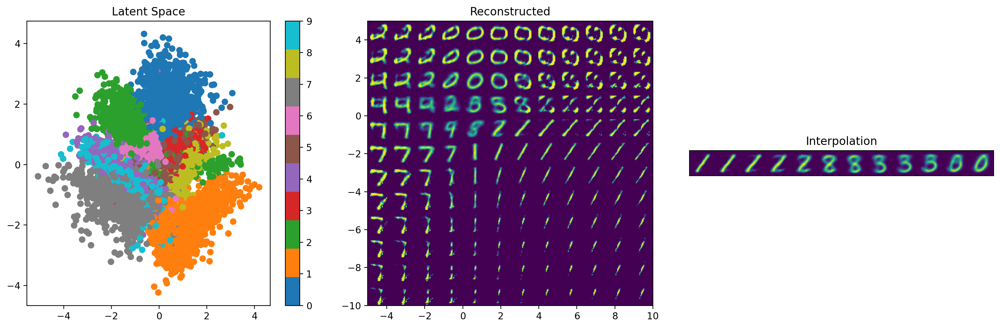

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


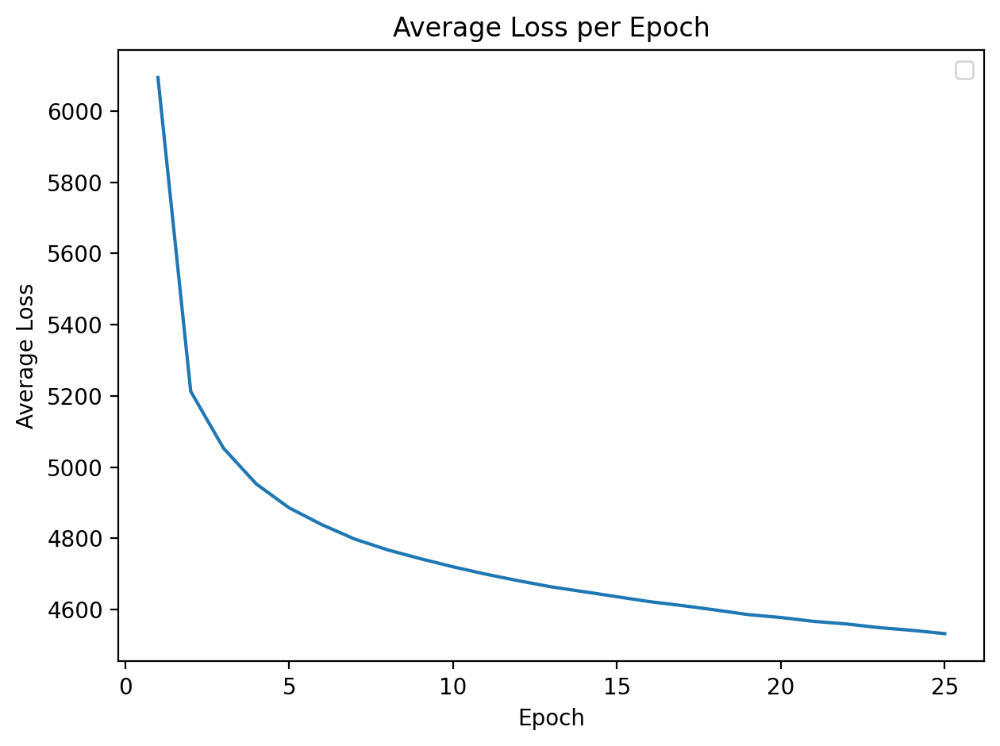

In [20]:
fig, axs = plt.subplots(1, 3, figsize=(15, 5))

plt.sca(axs[0])
plot_latent(betavae, data)
axs[0].set_title(f'Latent Space')

plt.sca(axs[1])
plot_reconstructed(betavae)
axs[1].set_title(f'Reconstructed')

plt.sca(axs[2])
x, y = next(iter(data))
x_1 = x[y == 1][0].to(device)
x_2 = x[y == 0][0].to(device)
interpolate(betavae, x_1, x_2)
axs[2].set_title(f'Interpolation')

plt.tight_layout()
plt.show()

plt.plot(range(1, 26), avg_losses)

plt.title("Average Loss per Epoch")
plt.xlabel("Epoch")
plt.ylabel("Average Loss")
plt.legend()
plt.tight_layout()
plt.show()

Zadanie 9

Evaluate VAE

In [21]:
def get_latents(autoencoder, dataloader):
    latents = []
    labels = []
    for x, y in dataloader:
        x = x.to(device)
        with torch.no_grad():
            z = autoencoder.encoder(x)
            latents.append(z.cpu())
            labels.append(y)
    return torch.cat(latents, dim=0), torch.cat(labels, dim=0)

In [22]:
from sklearn.manifold import TSNE
import matplotlib.pyplot as plt
import numpy as np

def analyze_tsne(latents, labels):
    tsne = TSNE(n_components=2)
    embedded = tsne.fit_transform(latents.numpy())

    fig, ax = plt.subplots(figsize=(5, 5))
    unique_labels = np.unique(labels.numpy())
    
    for cls in unique_labels:
        idxs = (labels.numpy() == cls)
        ax.scatter(embedded[idxs, 0], embedded[idxs, 1], label=str(cls), s=3)
        
    ax.set_title("t-SNE analysis")
    ax.legend(loc="center left", bbox_to_anchor=(1, 0.5), scatterpoints=10)
    plt.show()


In [21]:
latents, labels = get_latents(vae, data)

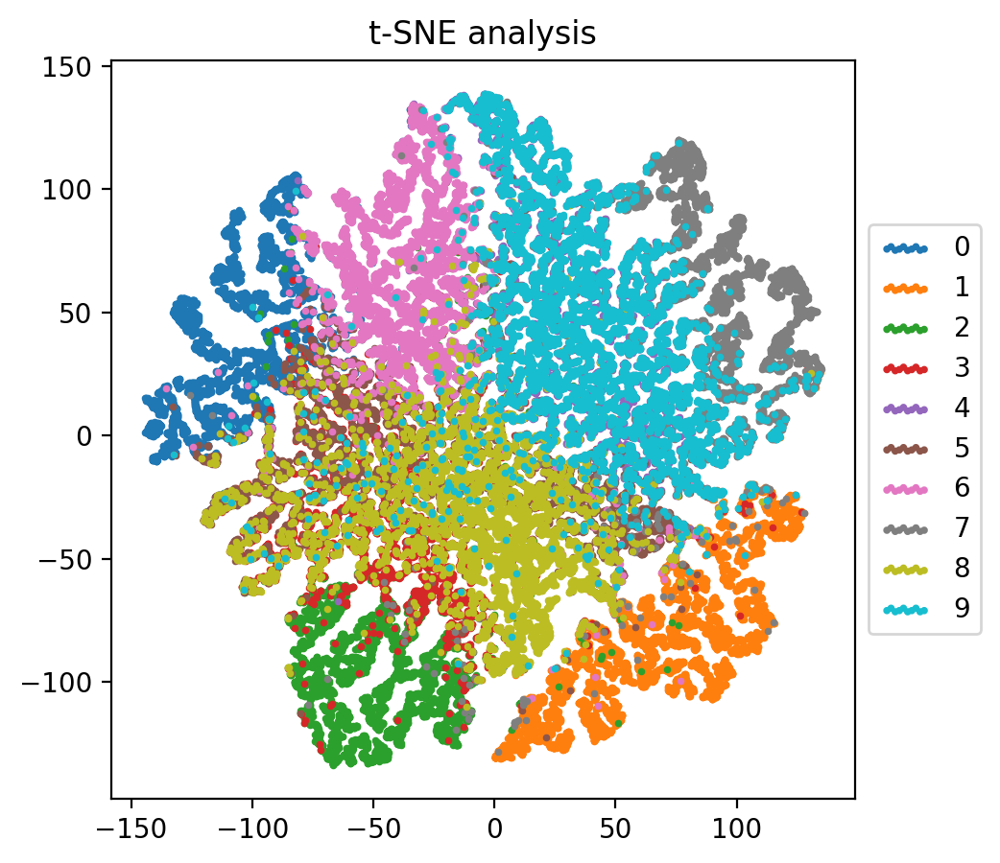

In [22]:
analyze_tsne(latents, labels)

In [27]:
def psnr(target, ref):
    target = target.cpu().detach().numpy()
    ref = ref.cpu().detach().numpy()
    
    mse = np.mean((target - ref) ** 2)
    
    if mse == 0:
        return float('inf')
    
    return 10 * np.log10(1.0 / mse)

def compute_average_psnr(vae, dataloader):
    total_psnr = 0.0
    num_batches = 0

    with torch.no_grad():
        for x, _ in dataloader:
            x = x.to(device)
            reconstructed_images = vae(x)
            total_psnr += psnr(x, reconstructed_images)
            num_batches += 1

    average_psnr = total_psnr / num_batches
    return average_psnr

In [30]:
avg_psnr = compute_average_psnr(vae, data)
print("Average PSNR:", avg_psnr)

Average PSNR: 13.91890757541109


In [28]:
from skimage.metrics import structural_similarity as compare_ssim
import numpy as np

def compute_avg_ssim(vae, dataloader):
    ssim_values = []

    with torch.no_grad():
        for x, _ in dataloader:
            x = x.to(device)
            reconstructed_images = vae(x)

            x_np = x.cpu().numpy()
            reconstructed_images_np = reconstructed_images.cpu().numpy()

            for orig_img, recon_img in zip(x_np, reconstructed_images_np):
                ssim = compare_ssim(orig_img[0], recon_img[0], data_range=1)
                ssim_values.append(ssim)

    avg_ssim = np.mean(ssim_values)

    return avg_ssim

In [31]:
avg_ssim = compute_avg_ssim(vae, data)
print(f"Average SSIM: {avg_ssim}")


Average SSIM: 0.5259909104592584


Evaluate AE

In [27]:
autoencoder = pickle.load(open('autoencoder.sav', 'rb'))

latents, labels = get_latents(autoencoder, data)

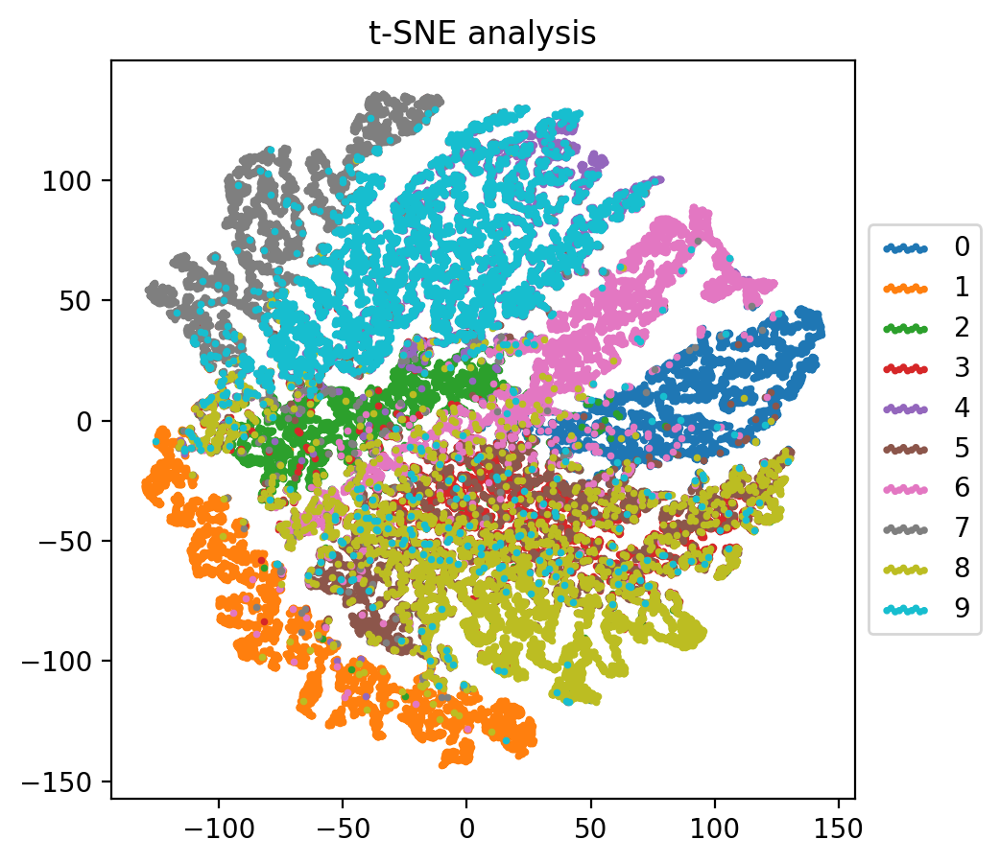

In [28]:
analyze_tsne(latents, labels)

In [32]:
avg_psnr = compute_average_psnr(autoencoder, data)
print("Average PSNR:", avg_psnr)

Average PSNR: 14.170431528204544


In [33]:
avg_ssim = compute_avg_ssim(autoencoder, data)
print(f"Average SSIM: {avg_ssim}")

Average SSIM: 0.5594431451703726


Evaluate Concrete VAE

In [27]:
concretevae = pickle.load(open('concretevae.sav', 'rb'))

def get_latents(model, dataloader):
    latents = []
    labels = []
    for x, y in dataloader:
        x = x.to(device)
        with torch.no_grad():
            logits = model.encoder(x.view(-1, 784))
            q_z = td.relaxed_categorical.RelaxedOneHotCategorical(temp, logits=logits)
            probs = q_z.probs
            latents.append(probs.cpu().reshape(-1, N*K))
            labels.append(y)
    return torch.cat(latents, dim=0), torch.cat(labels, dim=0)

latents, labels = get_latents(concretevae, data)

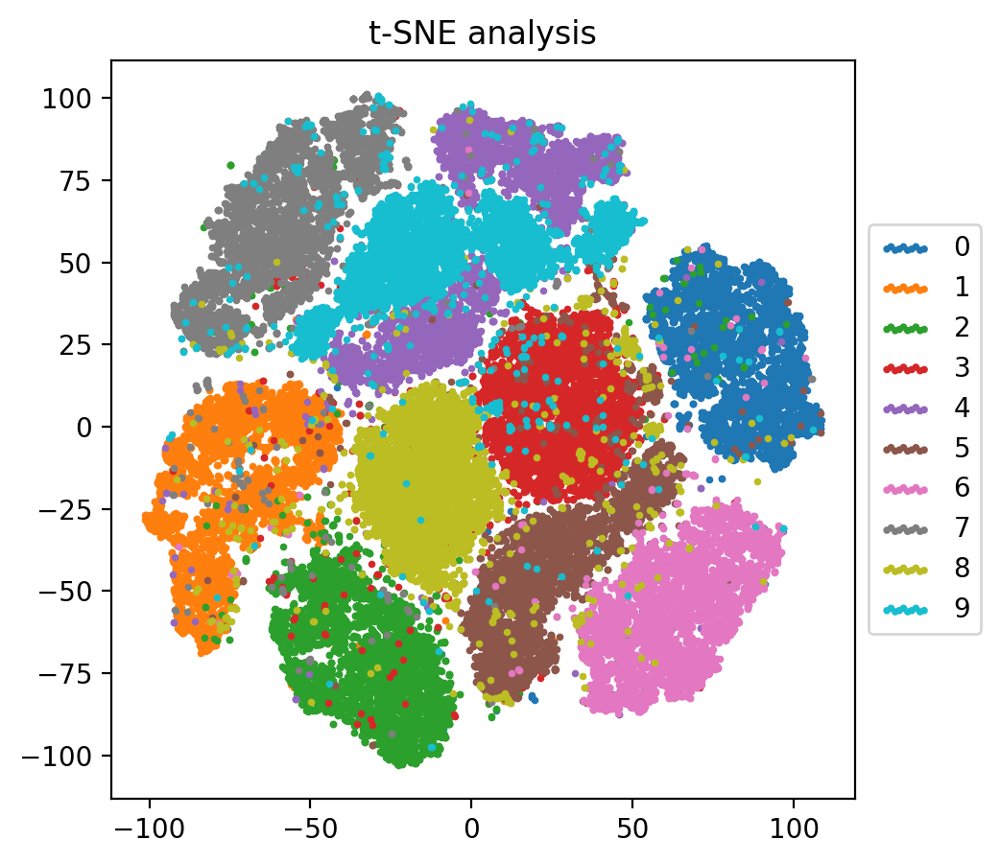

In [20]:
analyze_tsne(latents, labels)

In [25]:
def psnr(target, ref):
    target = target.cpu().detach().numpy()
    ref = ref.cpu().detach().numpy()
    
    mse = np.mean((target - ref) ** 2)
    
    if mse == 0:
        return float('inf')
    
    return 10 * np.log10(1.0 / mse)

def compute_average_psnr(vae, dataloader):
    total_psnr = 0.0
    num_batches = 0

    with torch.no_grad():
        for x, _ in dataloader:
            x = x.to(device)
            reconstructed_images_flat, _ = vae(x.view(-1, 784))
            reconstructed_images = reconstructed_images_flat.view(x.size())
            total_psnr += psnr(x, reconstructed_images)
            num_batches += 1

    average_psnr = total_psnr / num_batches
    return average_psnr


In [26]:
avg_psnr = compute_average_psnr(concretevae, data)
print("Average PSNR:", avg_psnr)

Average PSNR: 17.02062137964697


In [26]:
def compute_avg_ssim(vae, dataloader):
    ssim_values = []

    with torch.no_grad():
        for x, _ in dataloader:
            x = x.to(device)
            reconstructed_images_flat, _ = vae(x.view(-1, 784))
            reconstructed_images = reconstructed_images_flat.view(x.size())

            x_np = x.cpu().numpy()
            reconstructed_images_np = reconstructed_images.cpu().numpy()

            for orig_img, recon_img in zip(x_np, reconstructed_images_np):
                ssim = compare_ssim(orig_img[0], recon_img[0], data_range=1)
                ssim_values.append(ssim)

    avg_ssim = np.mean(ssim_values)

    return avg_ssim

In [29]:
avg_ssim = compute_avg_ssim(concretevae, data)
print(f"Average SSIM: {avg_ssim}")

Average SSIM: 0.7568312043649414


Evaluate Beta VAE

In [23]:
latents, labels = get_latents(betavae, data)

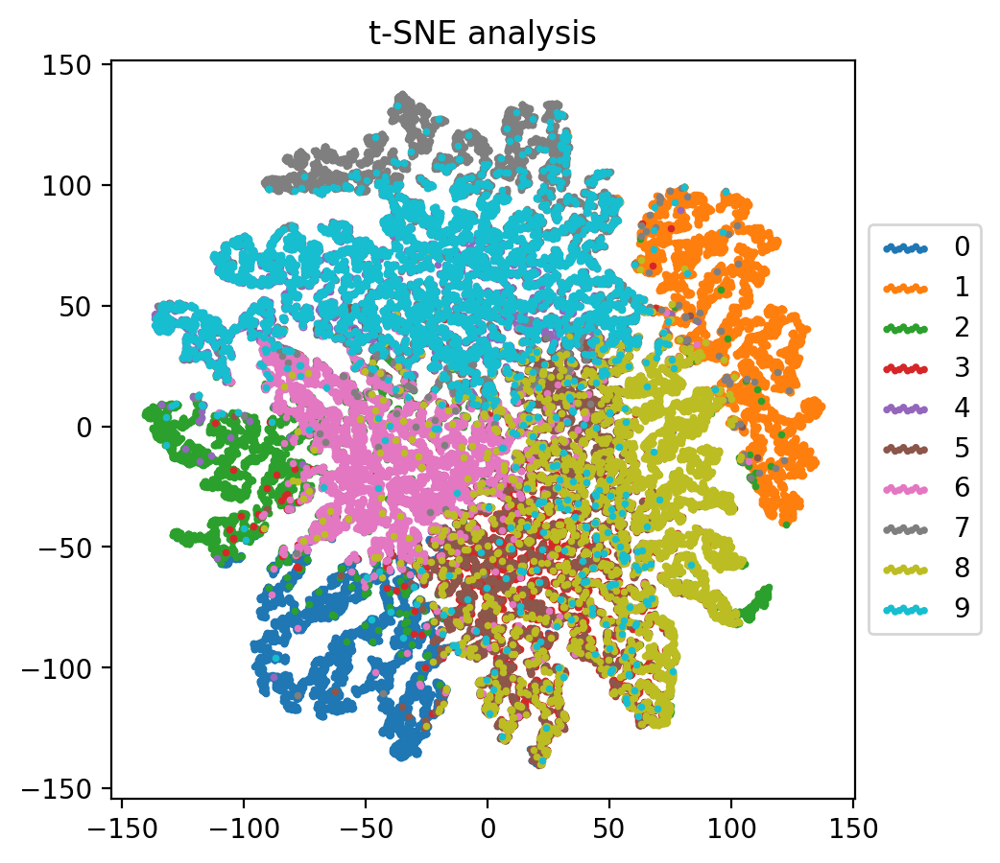

In [24]:
analyze_tsne(latents, labels)

In [29]:
avg_psnr = compute_average_psnr(betavae, data)
print("Average PSNR:", avg_psnr)

Average PSNR: 13.930592322128716


In [30]:
avg_ssim = compute_avg_ssim(betavae, data)
print(f"Average SSIM: {avg_ssim}")

Average SSIM: 0.5284190198167723
